# dataset clean (1444) Optimasi Hyperparameter

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os
import random
import cv2
import shutil
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
from sklearn.model_selection import KFold
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
from tensorflow.keras.applications import DenseNet169
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Dropout, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam,RMSprop
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.callbacks import ReduceLROnPlateau
from PIL import Image

In [2]:
# Lokasi dataset asli
base_dir = r'..\..\dataset\Dataset 1444'
train_dir = r'..\..\dataset\Batik Djawa\train'
test_dir = r'..\..\dataset\Batik Djawa\test'

# Membuat folder untuk data train dan test jika belum ada
os.makedirs(train_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

Jumlah data Kawung: 288
Jumlah data Mega Mendung: 288
Jumlah data Parang: 288
Jumlah data Truntum: 288
Jumlah Dataset : 1152


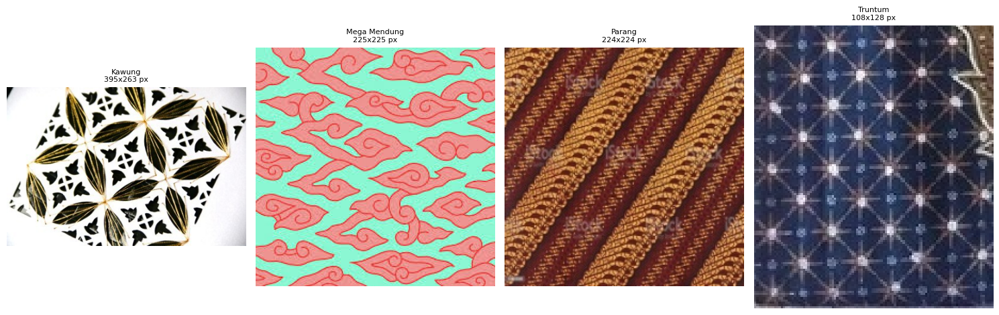

In [5]:
# ## Menampilkan Jumlah Dataset dari setiap kelas
total_dataset = 0
# dataset_dir = r'..\dataset\Dataset Batik Jawa'
folders = [folder for folder in os.listdir(train_dir) if os.path.isdir(os.path.join(train_dir, folder))]
fig, axes = plt.subplots(1, len(folders), figsize=(15, 5))  # Mengatur jumlah kolom berdasarkan jumlah folder

for i, folder in enumerate(folders):
    folder_path = os.path.join(train_dir, folder)
    image_count = len(os.listdir(folder_path))
    total_dataset += image_count
    print(f"Jumlah data {folder}: {image_count}")

    # Menampilkan foto secara acak dari setiap folder
    try:
        image_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]
        if image_files:
            random_image = random.choice(image_files)
            image_path = os.path.join(folder_path, random_image)
            img = Image.open(image_path)
            width, height = img.size

            # Menampilkan gambar di subplot horizontal
            axes[i].imshow(img)
            axes[i].set_title(f"{folder}\n{width}x{height} px", fontsize=8)
            axes[i].axis('off')
        else:
            print(f"Tidak ada gambar yang ditemukan di folder '{folder}'")
    except Exception as e:
        print(f"Error menampilkan gambar dari folder '{folder}': {e}")


print(f"Jumlah Dataset : {total_dataset}")
plt.tight_layout()
plt.show()

In [3]:
IMAGE_WIDTH = 224
IMAGE_HEIGHT = 224
IMAGE_SIZE = (IMAGE_WIDTH, IMAGE_HEIGHT)
BATCH_SIZE = 32
COLOR_CHANNELS = 3

In [11]:
# Ambil semua file gambar dari dataset asli
file_paths = []
labels = []

# Ambil file dari train_dir (data asli)
for label in os.listdir(train_dir):
    label_path = os.path.join(train_dir, label)
    if os.path.isdir(label_path):
        for file in os.listdir(label_path):
            file_paths.append(os.path.join(label_path, file))
            labels.append(label)

# Map label ke integer
unique_labels = sorted(set(labels))
label_map = {label: idx for idx, label in enumerate(unique_labels)}
integer_labels = [label_map[label] for label in labels]

print(f"Jumlah total gambar: {len(file_paths)}")
print(unique_labels)
print(len(label_map))
print(label_map)
print(integer_labels)

Jumlah total gambar: 1152
['Kawung', 'Mega Mendung', 'Parang', 'Truntum']
4
{'Kawung': 0, 'Mega Mendung': 1, 'Parang': 2, 'Truntum': 3}
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [4]:
# Fungsi preprocessing menggunakan CLAHE
# CLAHE akan meningkatkan kontras gambar sehingga fitur lebih terlihat
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
def preprocess_image(image):
    # Konversi nilai dari 0-1 ke 0-255 dan ubah tipe data ke uint8
    image = (image * 255).astype(np.uint8)
    
    # Konversi ke LAB color space
    lab = cv2.cvtColor(image, cv2.COLOR_RGB2LAB)
    
    # Pisahkan channel L, A, dan B
    l, a, b = cv2.split(lab)
    
    # Terapkan CLAHE pada channel L (grayscale)
    l = clahe.apply(l)
    
    # Gabungkan kembali ke LAB
    lab = cv2.merge((l, a, b))
    
    # Konversi kembali ke RGB
    image = cv2.cvtColor(lab, cv2.COLOR_LAB2RGB)
    
    # Normalisasi kembali ke 0-1
    image = image / 255.0
    return image

In [5]:
datagen = ImageDataGenerator(
    preprocessing_function=preprocess_image
)

test_generator = datagen.flow_from_directory(
    directory=test_dir,
    target_size=IMAGE_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    color_mode='rgb',
    shuffle=False
)

Found 292 images belonging to 4 classes.


In [10]:
val_generator = datagen.flow_from_directory(
        directory=train_dir,
        target_size=IMAGE_SIZE,
        batch_size=BATCH_SIZE,
        class_mode='categorical',
        shuffle=True, 
        subset='validation'
    )

Found 0 images belonging to 4 classes.


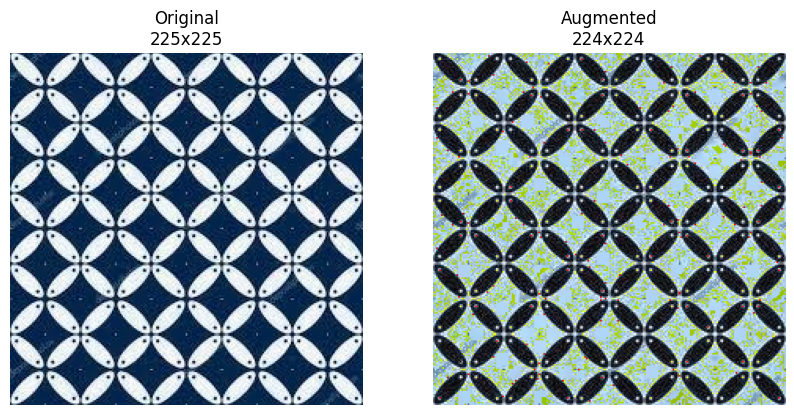

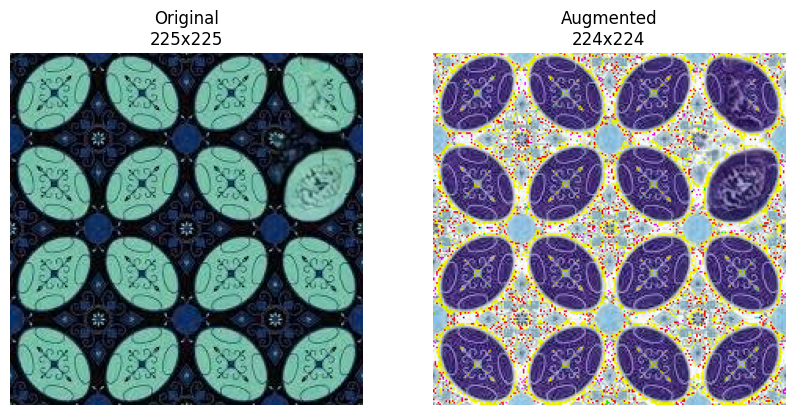

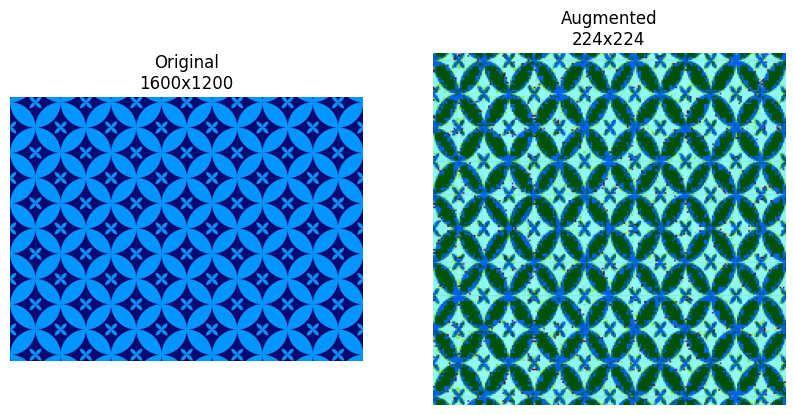

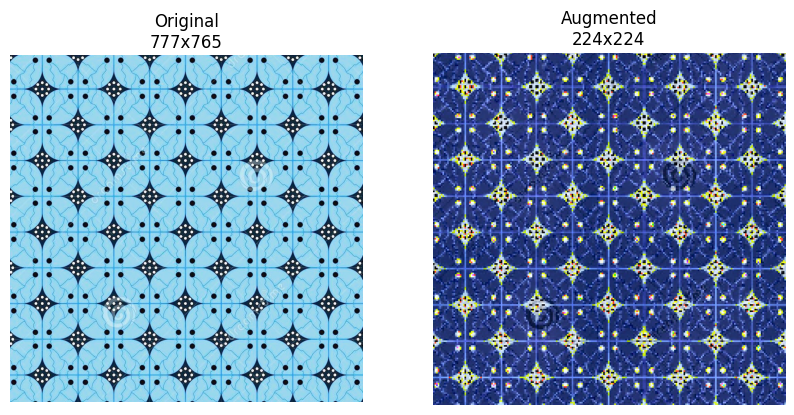

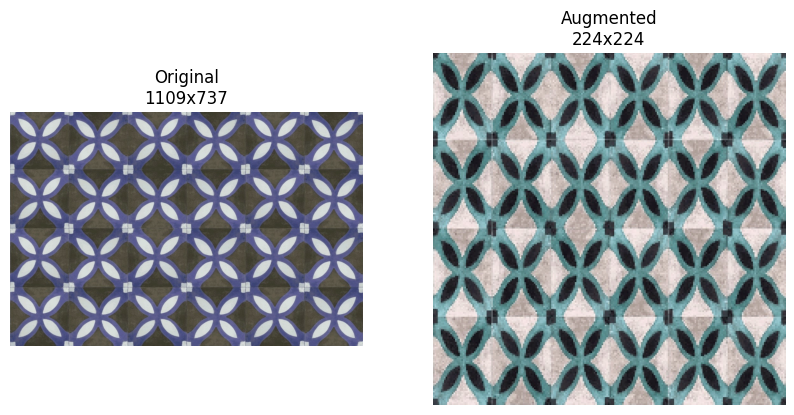

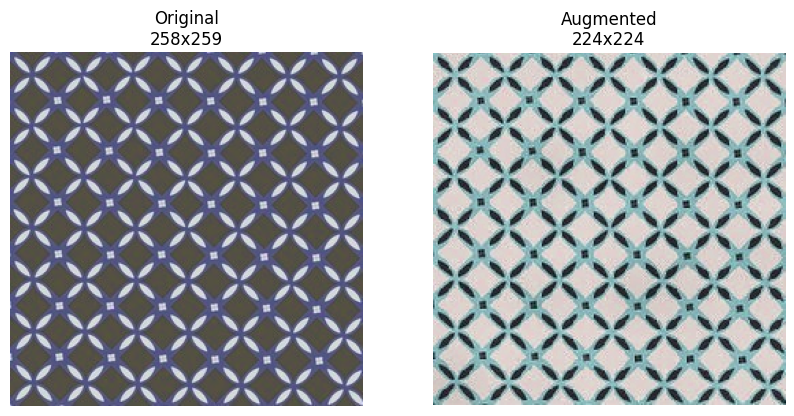

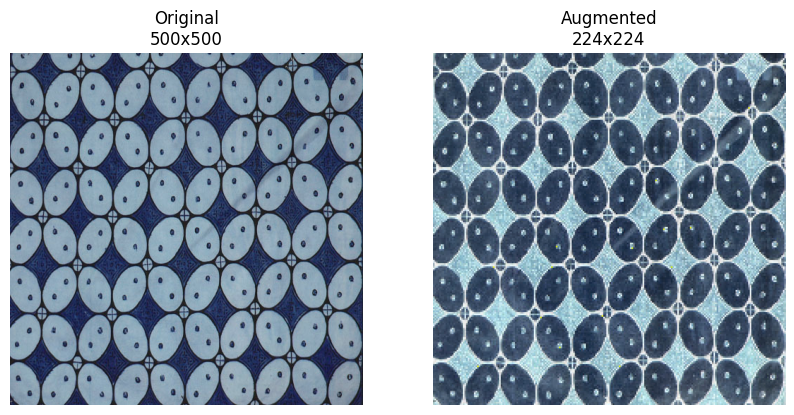

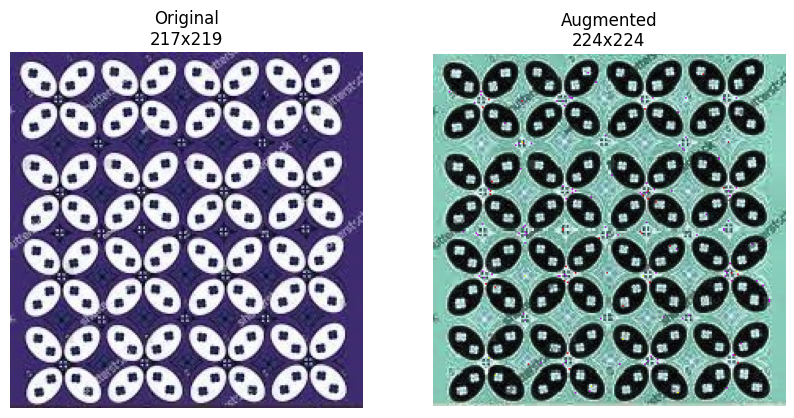

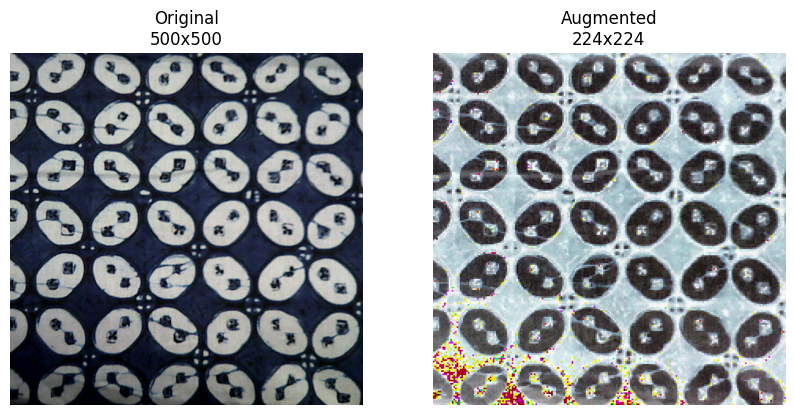

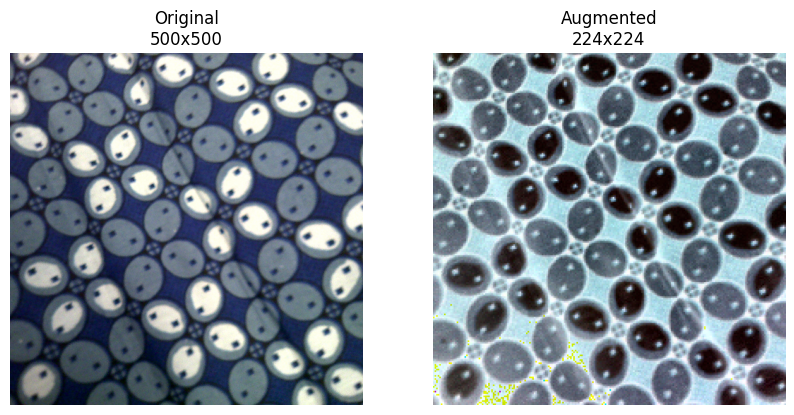

In [8]:
# Get a batch of images from the test generator
images, labels = next(test_generator)

for i in range(len(test_generator)):
    # Original image (assuming images are loaded with cv2)
    img_path = test_generator.filepaths[test_generator.index_array[i]]
    original_image = cv2.imread(img_path)
    
    # Augmented image from the test generator
    augmented_image = images[i]

    # Get image dimensions
    height_original, width_original, _ = original_image.shape
    height_augmented, width_augmented, _ = augmented_image.shape

    # Display the images
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(original_image)
    axes[0].set_title(f"Original\n{width_original}x{height_original}")
    axes[0].axis("off")

    axes[1].imshow(augmented_image)
    axes[1].set_title(f"Augmented\n{width_augmented}x{height_augmented}")
    axes[1].axis("off")
    plt.show()

## coba model train full conv5 (232 layer)

In [23]:
def create_model(num_classes):
    base_model = DenseNet169(weights='imagenet', include_top=False, input_shape=(IMAGE_WIDTH, IMAGE_HEIGHT, COLOR_CHANNELS))
    
    # base_model.trainable = True  # Base model dibekukan

    for layer in base_model.layers:
      if 'conv5' in layer.name:
        layer.trainable = True
      else:
        layer.trainable = False

    x = base_model.output
    x = Conv2D(32, (4, 4), activation='relu')(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(0.3)(x)
    x = Dense(64, activation='relu', name='FC2')(x) 
    x = Dropout(0.3)(x)
    x = Flatten()(x)
    x = Dropout(0.3)(x)
    predictions = Dense(num_classes, activation='softmax')(x)
    model = Model(inputs=base_model.input, outputs=predictions)
    model.compile(optimizer=RMSprop(0.0001), loss='categorical_crossentropy', metrics=['accuracy'])
    
    print("Total jumlah layer:", len(model.layers))

    print("Total trainable layers:", len([layer for layer in model.layers if layer.trainable]))
    model.summary()
    return model

# Direktori untuk menyimpan model terbaik
best_model_dir = r'.\keras' # Mendefinisikan best_model_dir di luar fungsi
os.makedirs(best_model_dir, exist_ok=True)

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True, verbose=1)
model_checkpoint = ModelCheckpoint(os.path.join(best_model_dir, 'conv5_coba_lagi.keras'), monitor='val_loss', save_best_only=True)

# Buat Learning Rate Scheduler
lr_scheduler = ReduceLROnPlateau(
    monitor='val_accuracy',     
    factor=0.1,             
    patience=3,             # Jika val_loss tidak membaik setelah 3 epoch, LR akan diturunkan
    min_lr=1e-6,            
    verbose=1               
)

num_classes = 4 # atau bagaimanapun Anda menentukan jumlah kelas
model = create_model(num_classes) # Panggil fungsi create_model dengan jumlah kelas yang benar

train_generator = datagen.flow_from_directory(
    directory=train_dir,
    target_size=IMAGE_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    subset='training',
    shuffle=True
)

val_generator = datagen.flow_from_directory(
    directory=train_dir,
    target_size=IMAGE_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    subset='validation',
    shuffle=True
)

# Training model tanpa KFold
EPOCHS = 20  # Ubah jumlah epoch menjadi 10
history = model.fit(
    train_generator,
    epochs=EPOCHS,
    validation_data=val_generator,
    callbacks=[early_stopping, model_checkpoint, lr_scheduler]
)

# Plot grafik akurasi dan loss dengan format yang lebih baik
plt.figure(figsize=(14, 6))

# Plot Training and Validation Accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Training Accuracy', marker='o')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy', marker='o')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim(0, 1)  # Menentukan rentang y antara 0 dan 1 (untuk akurasi)
plt.grid(True)
plt.legend()

# Plot Training and Validation Loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Training Loss', marker='o')
plt.plot(history.history['val_loss'], label='Validation Loss', marker='o')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.grid(True)
plt.legend()

# Buat figure Box Plot
plt.figure(figsize=(10, 6))

# Boxplot untuk Training & Validation Accuracy
plt.subplot(1, 2, 1)
plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
            labels=['Training Accuracy', 'Validation Accuracy'])
plt.title('Distribusi Akurasi')
plt.ylabel('Accuracy')
plt.ylim(0, 1)
plt.grid(True)

# Boxplot untuk Training & Validation Loss
plt.subplot(1, 2, 2)
plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,
            labels=['Training Loss', 'Validation Loss'])
plt.title('Distribusi Loss')
plt.ylabel('Loss')
plt.grid(True)

# Tampilkan grafik
plt.tight_layout()
plt.show()

Total jumlah layer: 603
Total trainable layers: 232


Model: "functional_12"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_12      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_24   │ (None, 230, 230,  │          0 │ input_layer_12[0… │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 112, 112,  │      9,408 │ zero_padding2d_2… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 112, 112,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 112, 112,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_25   │ (None, 114, 114,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 56, 56,    │          0 │ zero_padding2d_2… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 56, 56,    │        256 │ pool1[0][0]       │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_relu │ (None, 56, 56,    │          0 │ conv2_block1_0_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 56, 56,    │      8,192 │ conv2_block1_0_r… │
│ (Conv2D)            │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 56, 56,    │        512 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 56, 56,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 56, 56,    │     36,864 │ conv2_block1_1_r… │
│ (Conv2D)            │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_concat │ (None, 56, 56,    │          0 │ pool1[0][0],      │
│ (Concatenate)       │ 96)               │            │ conv2_block1_2_c… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_bn   │ (None, 56, 56,    │        384 │ conv2_block1_con… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_relu │ (None, 56, 56,    │          0 │ conv2_block2_0_b… │
│ (Activation)        │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_1_conv │ (None, 56, 56,    │     12,288 │ conv2_block2_0_r

 Total params: 13,498,020 (51.49 MB)

 Trainable params: 6,768,740 (25.82 MB)

 Non-trainable params: 6,729,280 (25.67 MB)

Found 1152 images belonging to 4 classes.
Found 0 images belonging to 4 classes.


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20


SystemError: D:\a\1\s\Objects\listobject.c:338: bad argument to internal function


🚀 Training Fold 1 😌

Found 921 validated image filenames belonging to 4 classes.
Found 231 validated image filenames belonging to 4 classes.
Total jumlah layer: 603
Total trainable layers: 232


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 174s 4s/step - accuracy: 0.4504 - loss: 1.3577 - val_accuracy: 0.8874 - val_loss: 0.4871 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 113s 4s/step - accuracy: 0.8190 - loss: 0.5305 - val_accuracy: 0.9048 - val_loss: 0.2603 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 88s 3s/step - accuracy: 0.8770 - loss: 0.3264 - val_accuracy: 0.9394 - val_loss: 0.1670 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 86s 3s/step - accuracy: 0.9060 - loss: 0.2429 - val_accuracy: 0.9264 - val_loss: 0.2405 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 89s 3s/step - accuracy: 0.9502 - loss: 0.1488 - val_accuracy: 0.9610 - val_loss: 0.1378 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 110s 4s/step - accuracy: 0.9530 - loss: 0.1260 - val_accuracy: 0.9654 - val_loss: 0.1197 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 108s 4s/step - accuracy: 0.9759 - l

C:\Users\ASUS\AppData\Local\Temp\ipykernel_14812\2131067240.py:128: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_14812\2131067240.py:137: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


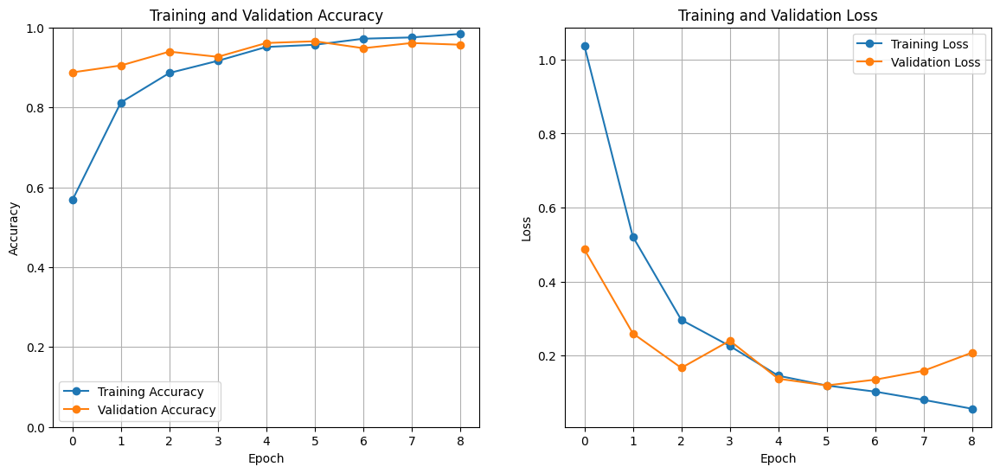

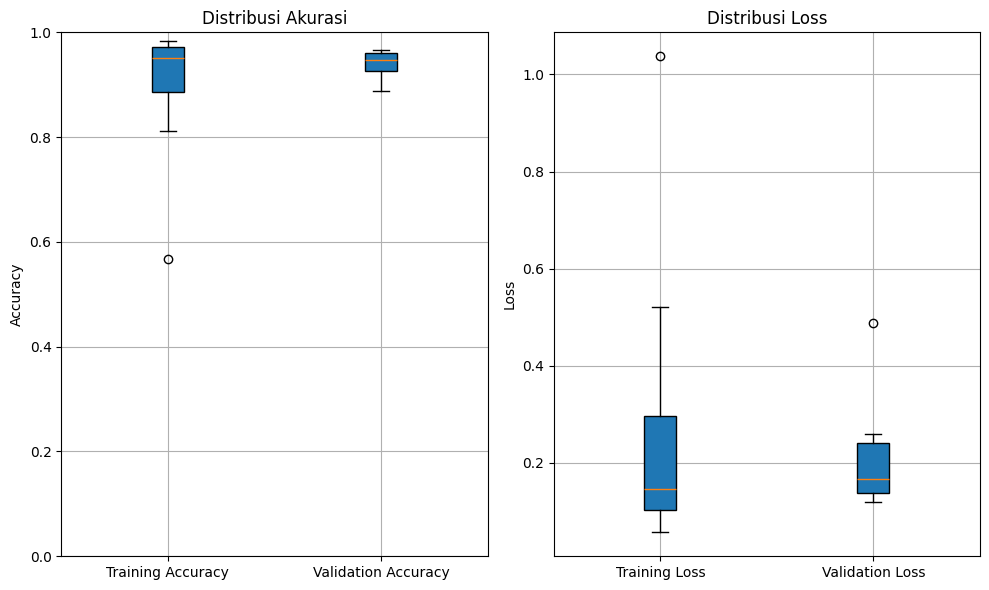


🚀 Training Fold 2 😌

Found 921 validated image filenames belonging to 4 classes.
Found 231 validated image filenames belonging to 4 classes.
Total jumlah layer: 603
Total trainable layers: 232


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 172s 5s/step - accuracy: 0.3973 - loss: 1.5078 - val_accuracy: 0.8009 - val_loss: 0.7095 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 128s 4s/step - accuracy: 0.7561 - loss: 0.6317 - val_accuracy: 0.9264 - val_loss: 0.3465 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 117s 4s/step - accuracy: 0.8512 - loss: 0.3965 - val_accuracy: 0.9654 - val_loss: 0.1737 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 107s 4s/step - accuracy: 0.8990 - loss: 0.2883 - val_accuracy: 0.9697 - val_loss: 0.1192 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 105s 4s/step - accuracy: 0.9468 - loss: 0.1678 - val_accuracy: 0.9697 - val_loss: 0.1220 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 118s 4s/step - accuracy: 0.9657 - loss: 0.0955 - val_accuracy: 0.9740 - val_loss: 0.1066 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 123s 4s/step - accuracy: 0.9665 

C:\Users\ASUS\AppData\Local\Temp\ipykernel_14812\2131067240.py:128: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_14812\2131067240.py:137: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


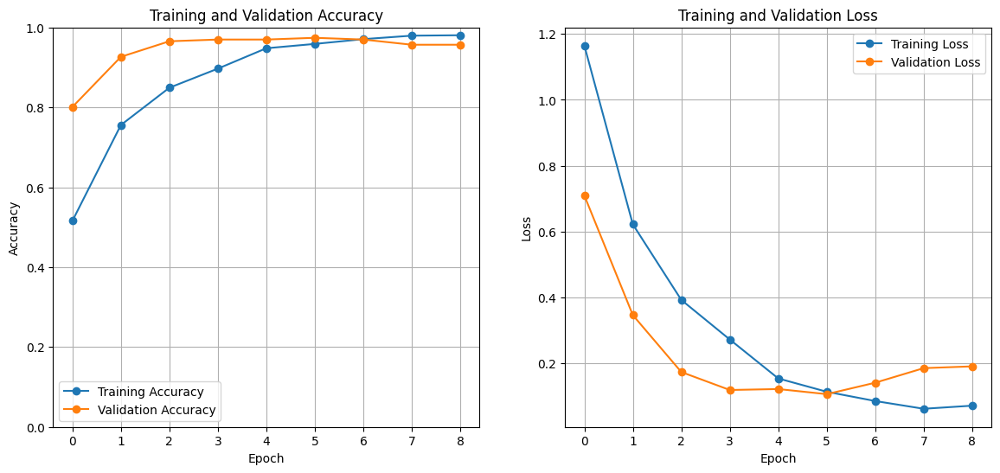

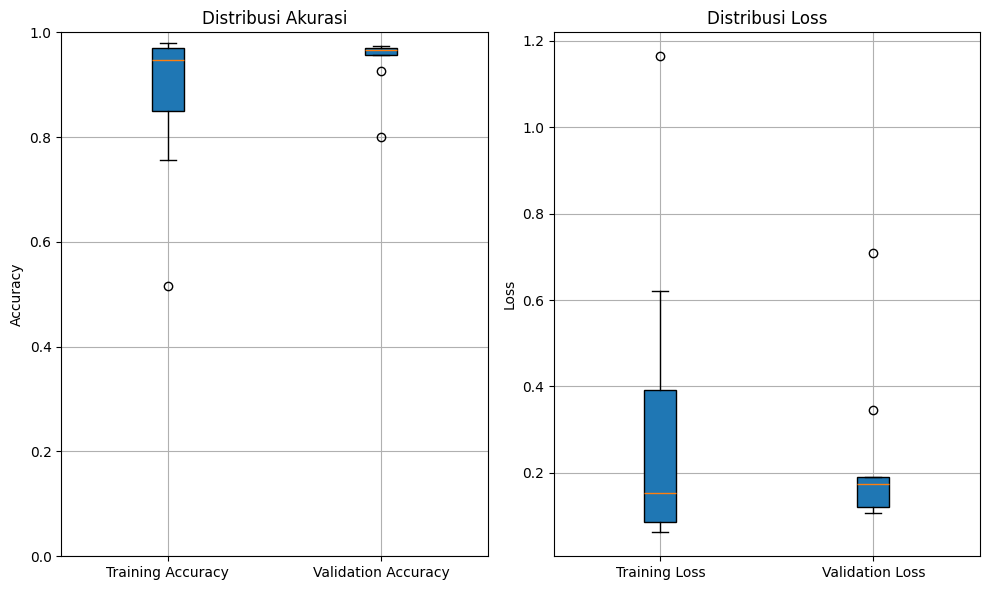


🚀 Training Fold 3 😌

Found 922 validated image filenames belonging to 4 classes.
Found 230 validated image filenames belonging to 4 classes.
Total jumlah layer: 603
Total trainable layers: 232


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 170s 5s/step - accuracy: 0.4111 - loss: 1.5719 - val_accuracy: 0.7522 - val_loss: 0.8318 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 121s 4s/step - accuracy: 0.7133 - loss: 0.7375 - val_accuracy: 0.8696 - val_loss: 0.4450 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 117s 4s/step - accuracy: 0.8182 - loss: 0.4734 - val_accuracy: 0.8913 - val_loss: 0.3417 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 119s 4s/step - accuracy: 0.8975 - loss: 0.2620 - val_accuracy: 0.9043 - val_loss: 0.3377 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 113s 4s/step - accuracy: 0.9349 - loss: 0.2010 - val_accuracy: 0.9000 - val_loss: 0.3400 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 119s 4s/step - accuracy: 0.9394 - loss: 0.1629 - val_accuracy: 0.9217 - val_loss: 0.2620 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 127s 4s/step - accuracy: 0.9576 

C:\Users\ASUS\AppData\Local\Temp\ipykernel_14812\2131067240.py:128: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_14812\2131067240.py:137: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


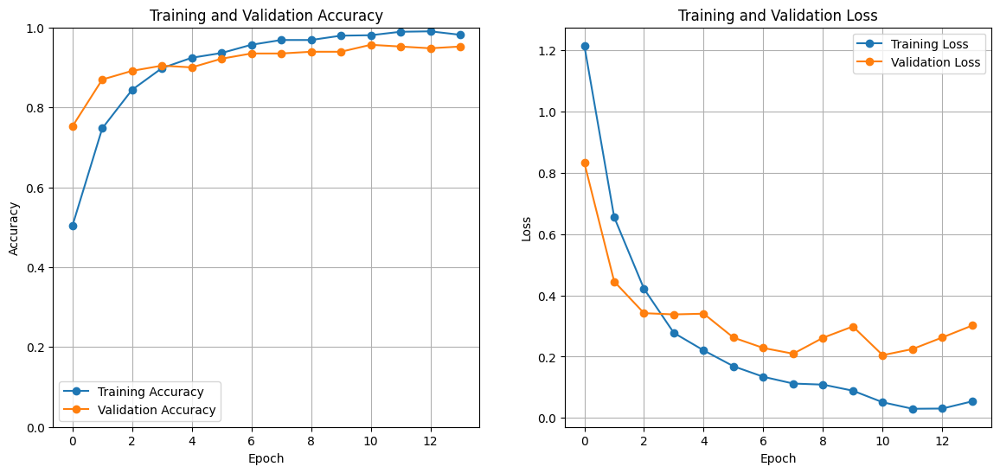

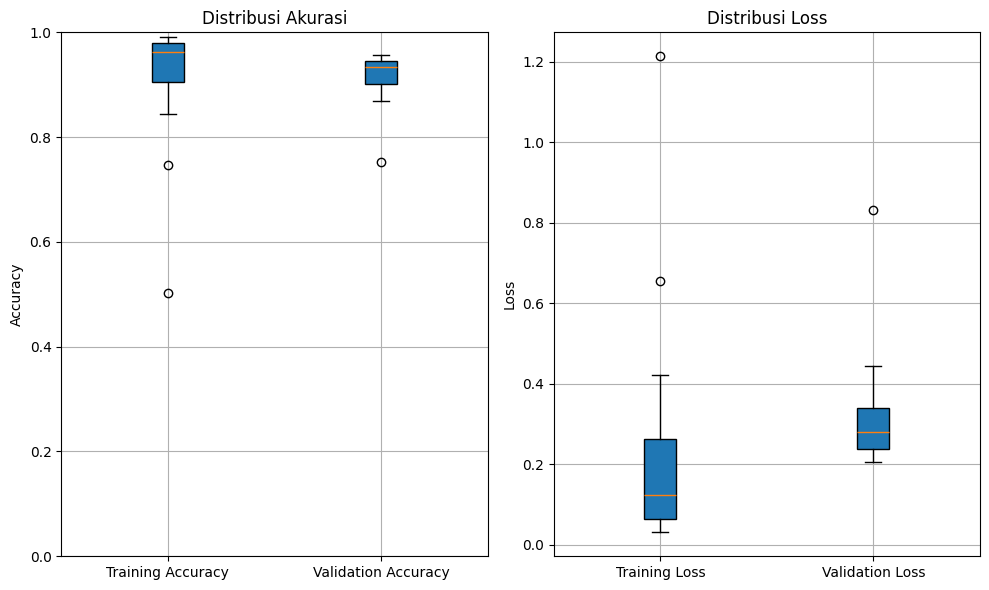


🚀 Training Fold 4 😌

Found 922 validated image filenames belonging to 4 classes.
Found 230 validated image filenames belonging to 4 classes.
Total jumlah layer: 603
Total trainable layers: 232


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 169s 4s/step - accuracy: 0.4525 - loss: 1.4050 - val_accuracy: 0.7739 - val_loss: 0.7176 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 123s 4s/step - accuracy: 0.7880 - loss: 0.5264 - val_accuracy: 0.8913 - val_loss: 0.3359 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 124s 4s/step - accuracy: 0.8680 - loss: 0.3409 - val_accuracy: 0.9565 - val_loss: 0.1988 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 123s 4s/step - accuracy: 0.9244 - loss: 0.2273 - val_accuracy: 0.9478 - val_loss: 0.1840 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 117s 4s/step - accuracy: 0.9468 - loss: 0.1698 - val_accuracy: 0.9435 - val_loss: 0.2096 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 118s 4s/step - accuracy: 0.9567 - loss: 0.1349 - val_accuracy: 0.9609 - val_loss: 0.2157 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 112s 4s/step - accuracy: 0.9506 

C:\Users\ASUS\AppData\Local\Temp\ipykernel_14812\2131067240.py:128: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_14812\2131067240.py:137: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


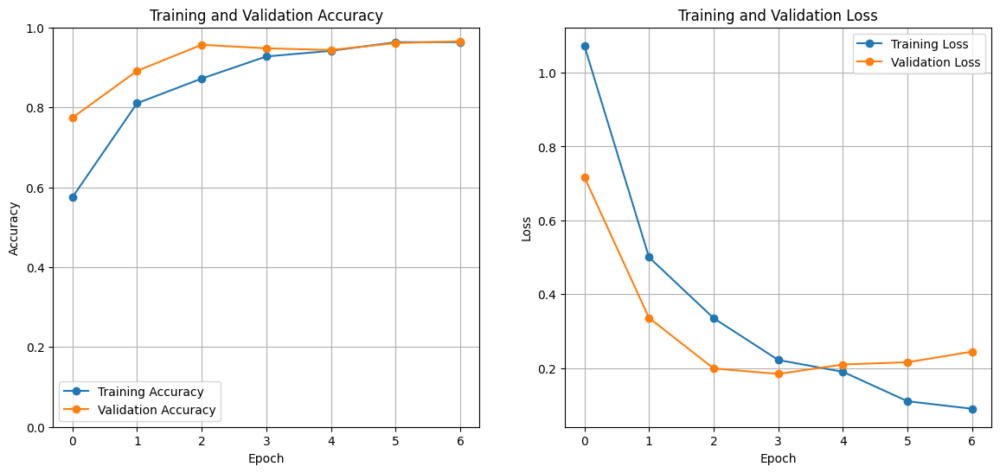

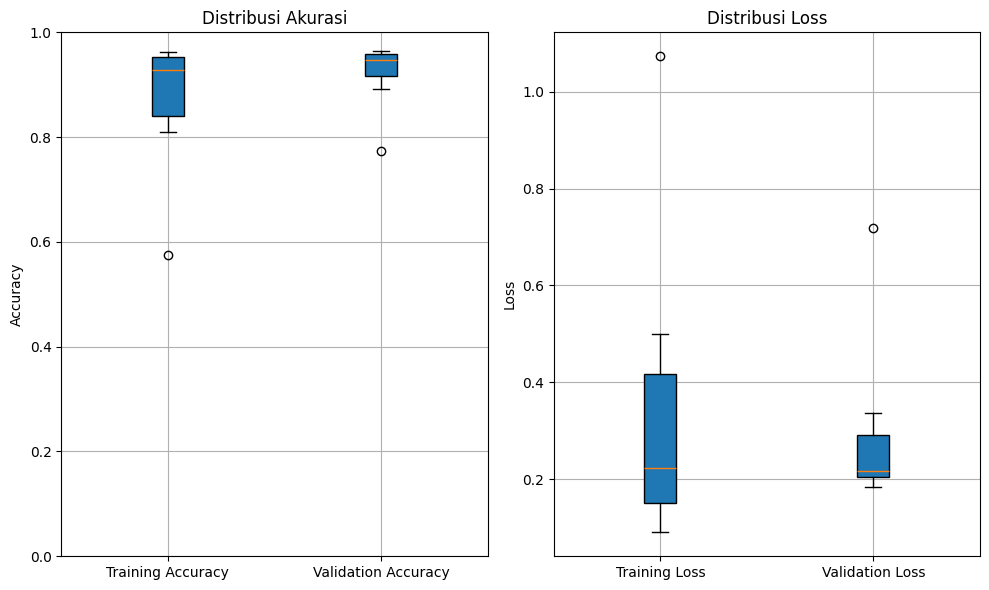


🚀 Training Fold 5 😌

Found 922 validated image filenames belonging to 4 classes.
Found 230 validated image filenames belonging to 4 classes.
Total jumlah layer: 603
Total trainable layers: 232


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 169s 4s/step - accuracy: 0.4406 - loss: 1.3775 - val_accuracy: 0.8174 - val_loss: 0.5945 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 130s 5s/step - accuracy: 0.7974 - loss: 0.6142 - val_accuracy: 0.8826 - val_loss: 0.3995 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 123s 4s/step - accuracy: 0.8707 - loss: 0.3703 - val_accuracy: 0.9609 - val_loss: 0.1555 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 122s 4s/step - accuracy: 0.9245 - loss: 0.2451 - val_accuracy: 0.9565 - val_loss: 0.1938 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 151s 5s/step - accuracy: 0.9335 - loss: 0.1711 - val_accuracy: 0.9739 - val_loss: 0.1165 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 114s 4s/step - accuracy: 0.9537 - loss: 0.1319 - val_accuracy: 0.9696 - val_loss: 0.1564 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 113s 4s/step - accuracy: 0.9718 

C:\Users\ASUS\AppData\Local\Temp\ipykernel_14812\2131067240.py:128: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_14812\2131067240.py:137: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


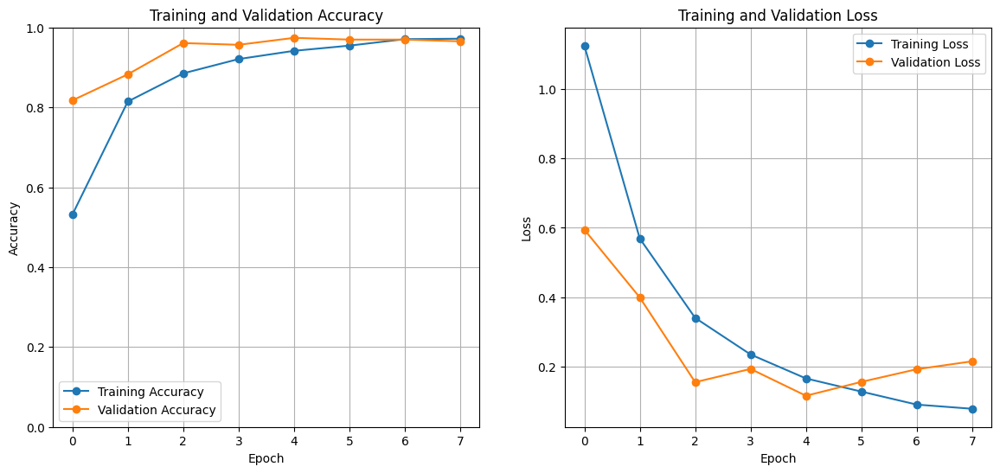

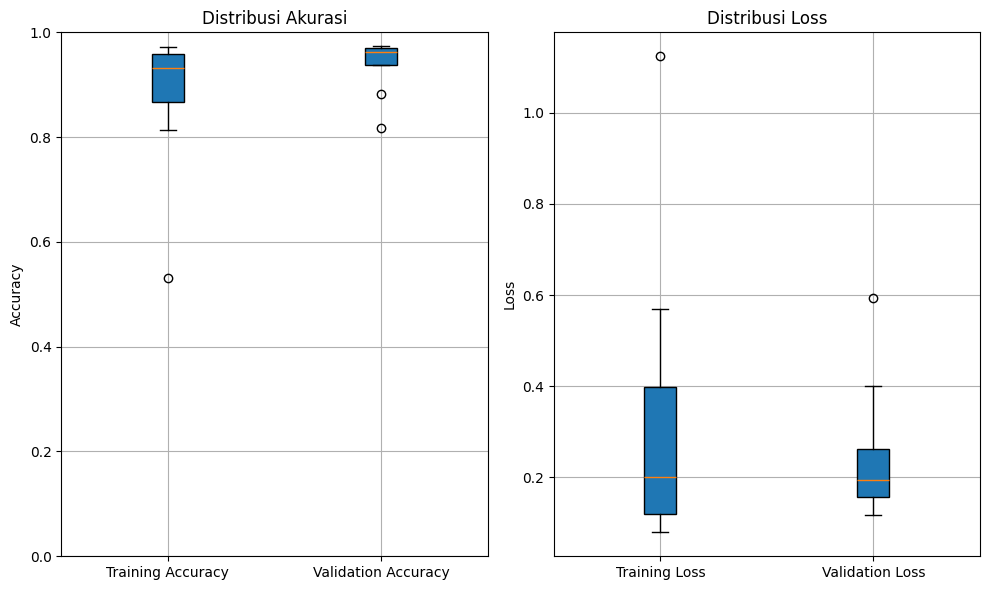

In [35]:
# Tentukan jumlah fold
n_splits = 5
kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

# Direktori untuk menyimpan model terbaik
best_model_dir = r'.\keras' 

# Fungsi untuk membuat model
def create_model(num_classes):
    base_model = DenseNet169(weights='imagenet', include_top=False, input_shape=(IMAGE_WIDTH, IMAGE_HEIGHT, COLOR_CHANNELS))

    for layer in base_model.layers:
      if 'conv5' in layer.name:
        layer.trainable = True
      else:
        layer.trainable = False

    x = base_model.output
    x = Conv2D(32, (4, 4), activation='relu')(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(0.3)(x)
    x = Dense(64, activation='relu', name='FC2')(x) 
    x = Dropout(0.3)(x)
    x = Flatten()(x)
    x = Dropout(0.3)(x)
    predictions = Dense(num_classes, activation='softmax')(x)
    model = Model(inputs=base_model.input, outputs=predictions)
    model.compile(optimizer=RMSprop(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])
    
    # Menampilkan jumlah total layer
    print("Total jumlah layer:", len(model.layers))

    print("Total trainable layers:", len([layer for layer in model.layers if layer.trainable]))
    # model.summary()
    return model

EPOCHS = 20
fold_var = 1

# Looping untuk setiap fold
for train_index, val_index in kf.split(file_paths):
    print(f"\n🚀 Training Fold {fold_var} 😌\n")

    # Split train and validation sets
    train_files, val_files = np.array(file_paths)[train_index], np.array(file_paths)[val_index]
    train_labels, val_labels = np.array(integer_labels)[train_index], np.array(integer_labels)[val_index]
    
    # Convert integer labels to class names
    df_train = pd.DataFrame({"filename": train_files, "class": [unique_labels[i] for i in train_labels]})
    df_val = pd.DataFrame({"filename": val_files, "class": [unique_labels[i] for i in val_labels]})


    train_generator = datagen.flow_from_dataframe(
        dataframe=df_train,       # DataFrame yang berisi informasi gambar (filename dan class)
        x_col="filename",         # Kolom yang berisi path ke gambar
        y_col="class",            # Kolom yang berisi label kelas gambar
        target_size=IMAGE_SIZE,   # Ukuran gambar yang akan diubah sebelum masuk ke model
        batch_size=BATCH_SIZE,    # Jumlah gambar yang akan diproses dalam satu batch
        class_mode="categorical", # Mode klasifikasi (multikategori)
        color_mode="rgb",         # Format warna gambar (RGB)
        shuffle=True
    )
    
    val_generator = datagen.flow_from_dataframe(
        dataframe=df_val,
        x_col="filename",
        y_col="class",
        target_size=IMAGE_SIZE,
        batch_size=BATCH_SIZE,
        class_mode="categorical",
        color_mode="rgb",
        shuffle=True
    )

    # Callbacks
    early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True, verbose=1)
    model_checkpoint = ModelCheckpoint(os.path.join(best_model_dir, f'conv5_model_{fold_var}.keras'), monitor='val_loss', save_best_only=True)
    
    # Buat Learning Rate Scheduler
    lr_scheduler = ReduceLROnPlateau(
        monitor='val_accuracy',     
        factor=0.1,             
        patience=3,             # Jika val_loss tidak membaik setelah 3 epoch, LR akan diturunkan
        min_lr=1e-6,            
        verbose=1               
    )

    num_classes = 4
    model = create_model(num_classes)

    # Training Model
    history = model.fit(
        train_generator,
        epochs=EPOCHS,
        validation_data=val_generator,
        callbacks=[early_stopping, model_checkpoint, lr_scheduler]
    )

    # Plot grafik akurasi dan loss dengan format yang lebih baik
    plt.figure(figsize=(14, 6))

    # Plot Training and Validation Accuracy
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Training Accuracy', marker='o')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy', marker='o')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.ylim(0, 1)  # Menentukan rentang y antara 0 dan 1 (untuk akurasi)
    plt.grid(True)
    plt.legend()

    # Plot Training and Validation Loss
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Training Loss', marker='o')
    plt.plot(history.history['val_loss'], label='Validation Loss', marker='o')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.grid(True)
    plt.legend()

    # Buat figure Box Plot
    plt.figure(figsize=(10, 6))
    
    # Boxplot untuk Training & Validation Accuracy
    plt.subplot(1, 2, 1)
    plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
                labels=['Training Accuracy', 'Validation Accuracy'])
    plt.title('Distribusi Akurasi')
    plt.ylabel('Accuracy')
    plt.ylim(0, 1)
    plt.grid(True)
    
    # Boxplot untuk Training & Validation Loss
    plt.subplot(1, 2, 2)
    plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,
                labels=['Training Loss', 'Validation Loss'])
    plt.title('Distribusi Loss')
    plt.ylabel('Loss')
    plt.grid(True)

    # Tampilkan grafik
    plt.tight_layout()
    plt.show()

    # menambah fold
    fold_var += 1

In [15]:
import numpy as np

# Contoh hasil akurasi dari 5 fold
accuracies = [96.54, 97.40, 95.65, 94.78, 97.39]

# Menghitung standar deviasi
std_dev = np.std(accuracies)

print(f"Standar Deviasi Akurasi Model P2: {std_dev:.4f}")


Standar Deviasi Akurasi Model P2: 1.0174


## coba model conv5 150


🚀 Training Fold 1 😌

Found 921 validated image filenames belonging to 4 classes.
Found 231 validated image filenames belonging to 4 classes.
Total jumlah layer: 603
Total trainable layers: 158


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 150s 4s/step - accuracy: 0.4249 - loss: 1.4153 - val_accuracy: 0.9091 - val_loss: 0.5410 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 100s 3s/step - accuracy: 0.7618 - loss: 0.6146 - val_accuracy: 0.9307 - val_loss: 0.2941 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 102s 4s/step - accuracy: 0.8680 - loss: 0.3911 - val_accuracy: 0.9567 - val_loss: 0.1742 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 102s 4s/step - accuracy: 0.8934 - loss: 0.2872 - val_accuracy: 0.9394 - val_loss: 0.1642 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 100s 3s/step - accuracy: 0.9314 - loss: 0.1796 - val_accuracy: 0.9481 - val_loss: 0.1433 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9455 - loss: 0.1458
Epoch 6: ReduceLROnPlateau reducing learning rate to 9.999999747378752e-06.
29/29 ━━━━━━━━━━━━━━━━━━━━ 102s 4s/step - accuracy: 0.9455 - loss:

C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\3696750729.py:126: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\3696750729.py:135: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


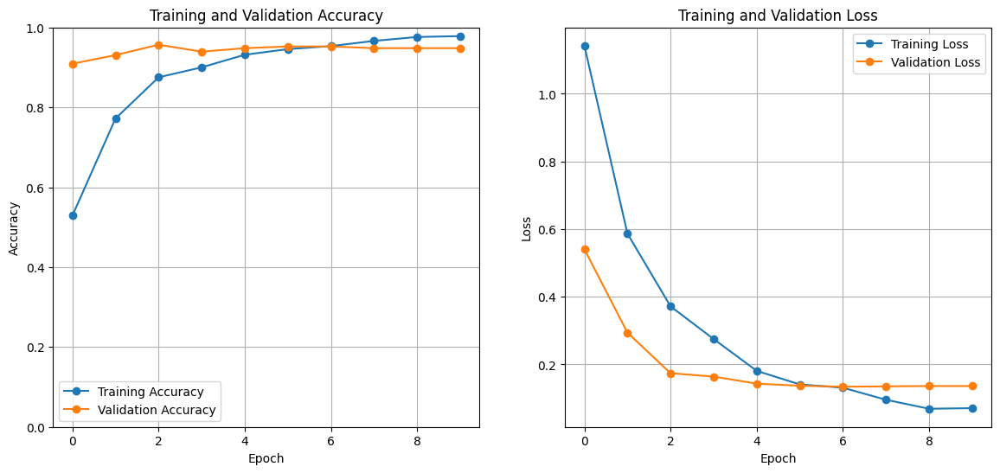

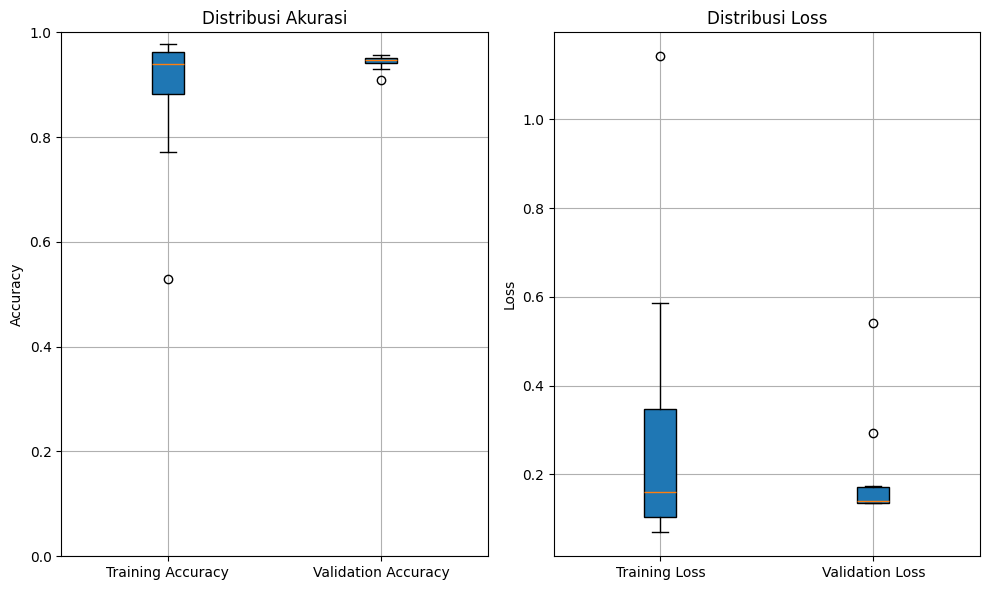


🚀 Training Fold 2 😌

Found 921 validated image filenames belonging to 4 classes.
Found 231 validated image filenames belonging to 4 classes.
Total jumlah layer: 603
Total trainable layers: 158


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 146s 4s/step - accuracy: 0.3582 - loss: 1.4887 - val_accuracy: 0.8658 - val_loss: 0.7121 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 102s 4s/step - accuracy: 0.6670 - loss: 0.8480 - val_accuracy: 0.9481 - val_loss: 0.3448 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 104s 4s/step - accuracy: 0.7994 - loss: 0.5258 - val_accuracy: 0.9481 - val_loss: 0.2134 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 105s 4s/step - accuracy: 0.8558 - loss: 0.3752 - val_accuracy: 0.9654 - val_loss: 0.1321 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 107s 4s/step - accuracy: 0.9008 - loss: 0.2697 - val_accuracy: 0.9610 - val_loss: 0.1316 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 105s 4s/step - accuracy: 0.9230 - loss: 0.1994 - val_accuracy: 0.9567 - val_loss: 0.1393 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9337 - 

C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\3696750729.py:126: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\3696750729.py:135: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


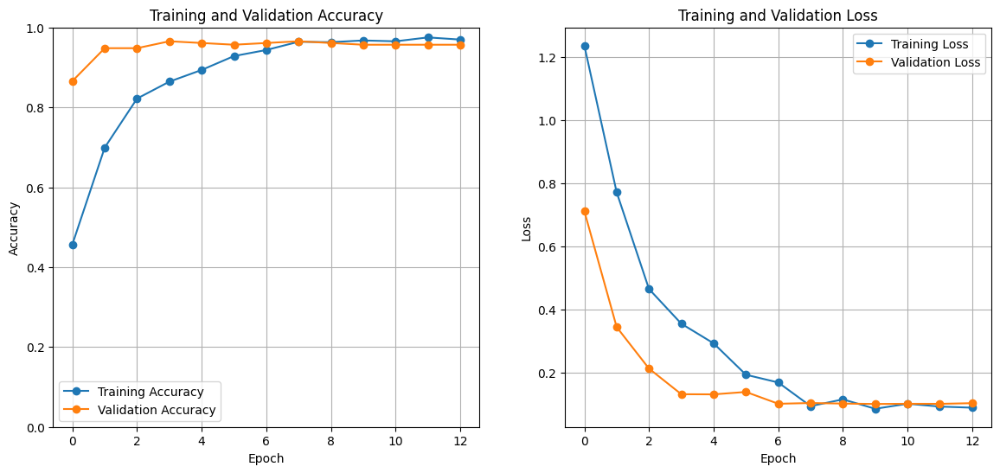

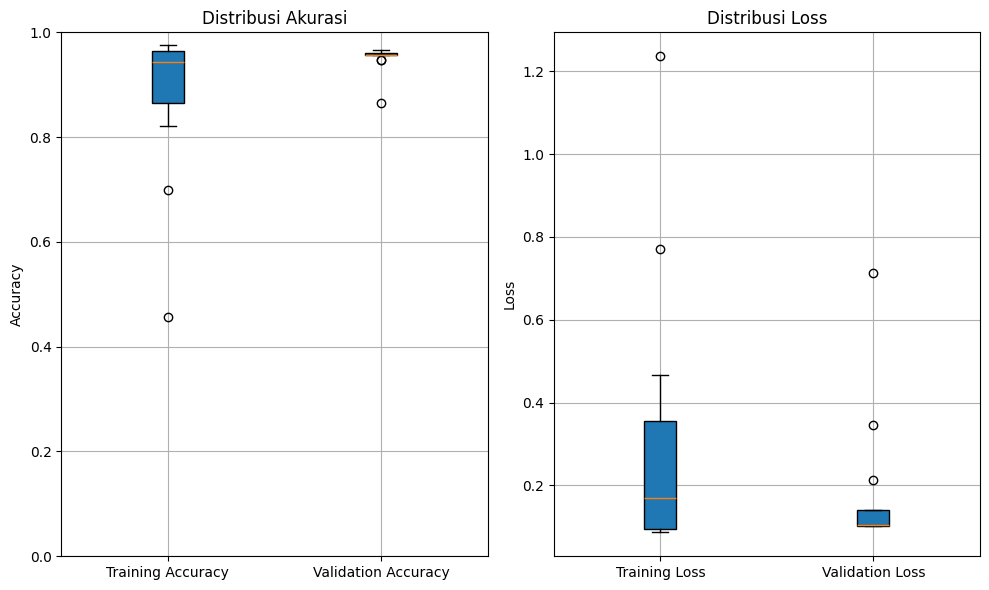


🚀 Training Fold 3 😌

Found 922 validated image filenames belonging to 4 classes.
Found 230 validated image filenames belonging to 4 classes.
Total jumlah layer: 603
Total trainable layers: 158


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 155s 4s/step - accuracy: 0.3611 - loss: 1.4949 - val_accuracy: 0.8217 - val_loss: 0.6576 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 128s 4s/step - accuracy: 0.7574 - loss: 0.6447 - val_accuracy: 0.8870 - val_loss: 0.3735 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 113s 4s/step - accuracy: 0.8507 - loss: 0.4544 - val_accuracy: 0.9217 - val_loss: 0.2429 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 95s 3s/step - accuracy: 0.9089 - loss: 0.2735 - val_accuracy: 0.9348 - val_loss: 0.1988 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 93s 3s/step - accuracy: 0.9152 - loss: 0.2704 - val_accuracy: 0.9304 - val_loss: 0.2043 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 102s 4s/step - accuracy: 0.9499 - loss: 0.1318 - val_accuracy: 0.9565 - val_loss: 0.1736 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 89s 3s/step - accuracy: 0.9593 - l

C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\3696750729.py:126: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\3696750729.py:135: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


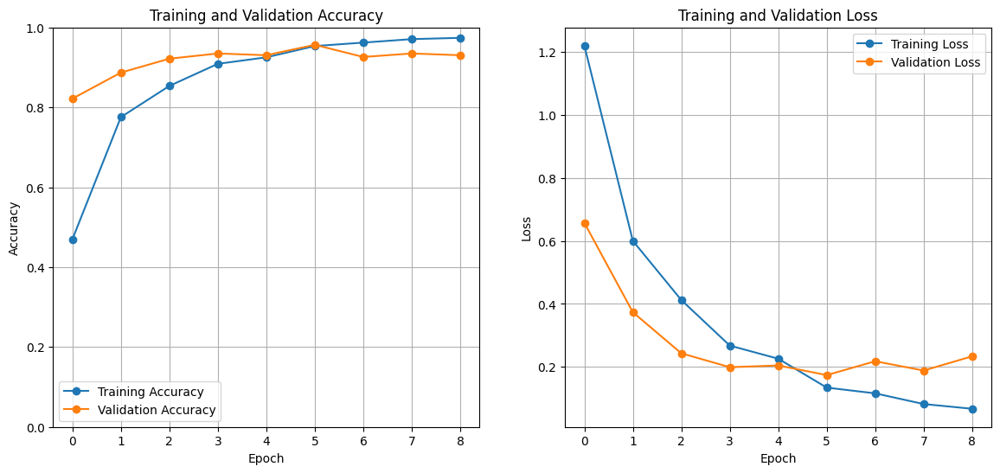

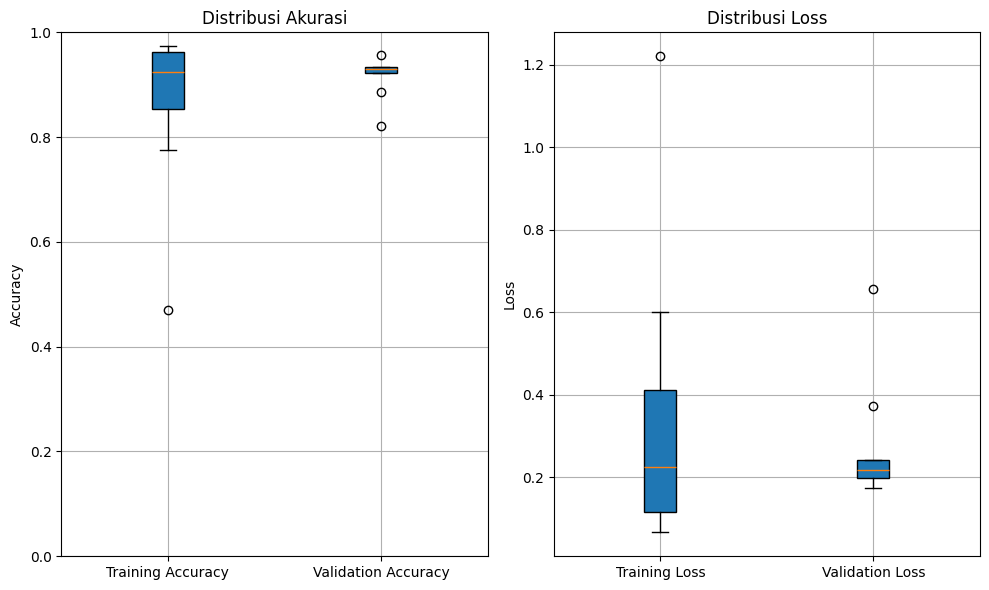


🚀 Training Fold 4 😌

Found 922 validated image filenames belonging to 4 classes.
Found 230 validated image filenames belonging to 4 classes.
Total jumlah layer: 603
Total trainable layers: 158


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 153s 4s/step - accuracy: 0.4425 - loss: 1.5614 - val_accuracy: 0.7478 - val_loss: 0.7349 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 98s 3s/step - accuracy: 0.7737 - loss: 0.5686 - val_accuracy: 0.8913 - val_loss: 0.4533 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 93s 3s/step - accuracy: 0.8657 - loss: 0.3809 - val_accuracy: 0.9391 - val_loss: 0.2886 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 95s 3s/step - accuracy: 0.9145 - loss: 0.2447 - val_accuracy: 0.9391 - val_loss: 0.2515 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 99s 3s/step - accuracy: 0.9045 - loss: 0.2468 - val_accuracy: 0.9304 - val_loss: 0.2636 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 97s 3s/step - accuracy: 0.9630 - loss: 0.1278 - val_accuracy: 0.9478 - val_loss: 0.2332 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 94s 3s/step - accuracy: 0.9654 - loss

C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\3696750729.py:126: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\3696750729.py:135: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


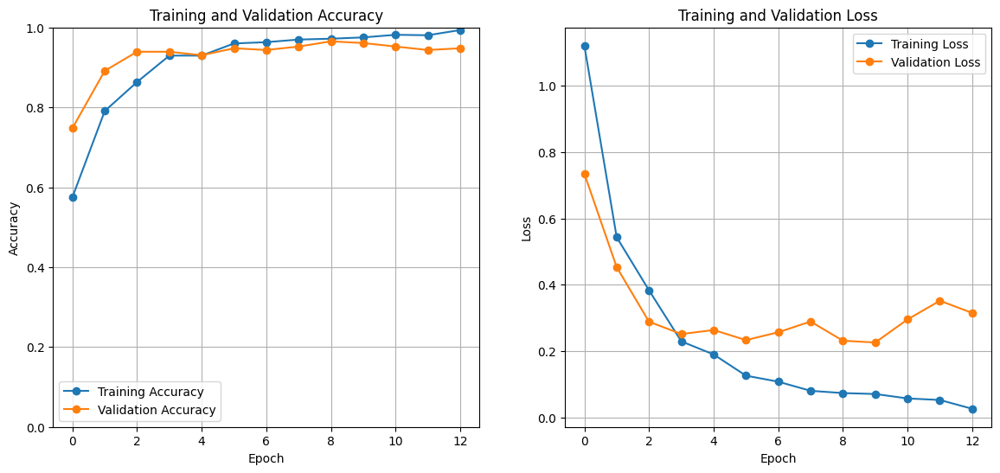

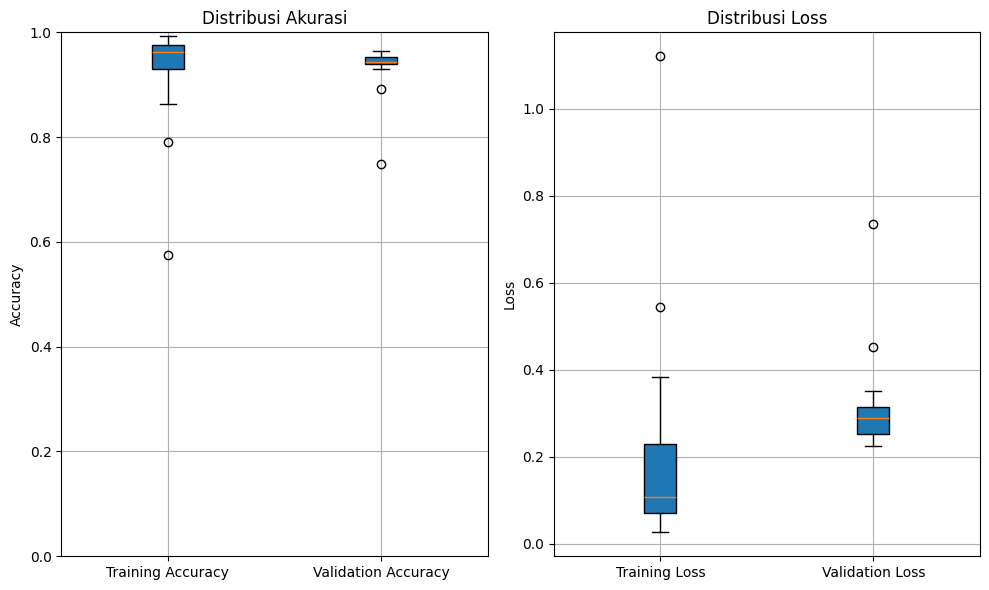


🚀 Training Fold 5 😌

Found 922 validated image filenames belonging to 4 classes.
Found 230 validated image filenames belonging to 4 classes.
Total jumlah layer: 603
Total trainable layers: 158


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 160s 5s/step - accuracy: 0.4165 - loss: 1.6168 - val_accuracy: 0.7783 - val_loss: 0.6898 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 123s 4s/step - accuracy: 0.7150 - loss: 0.7243 - val_accuracy: 0.9391 - val_loss: 0.3576 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 105s 4s/step - accuracy: 0.8396 - loss: 0.4427 - val_accuracy: 0.9435 - val_loss: 0.2131 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 113s 4s/step - accuracy: 0.8807 - loss: 0.3120 - val_accuracy: 0.9609 - val_loss: 0.1337 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 109s 4s/step - accuracy: 0.9289 - loss: 0.1967 - val_accuracy: 0.9565 - val_loss: 0.1546 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 114s 4s/step - accuracy: 0.9618 - loss: 0.1492 - val_accuracy: 0.9565 - val_loss: 0.1038 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 113s 4s/step - accuracy: 0.9676 

C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\3696750729.py:126: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\3696750729.py:135: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


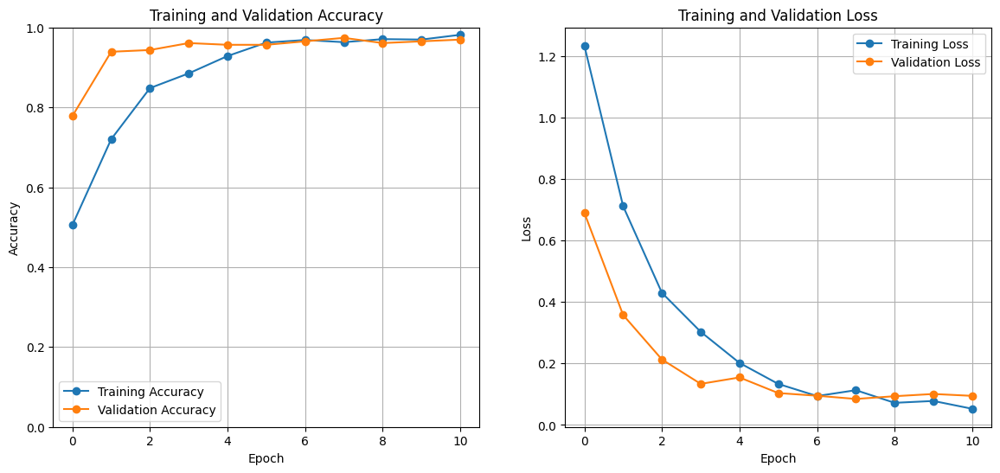

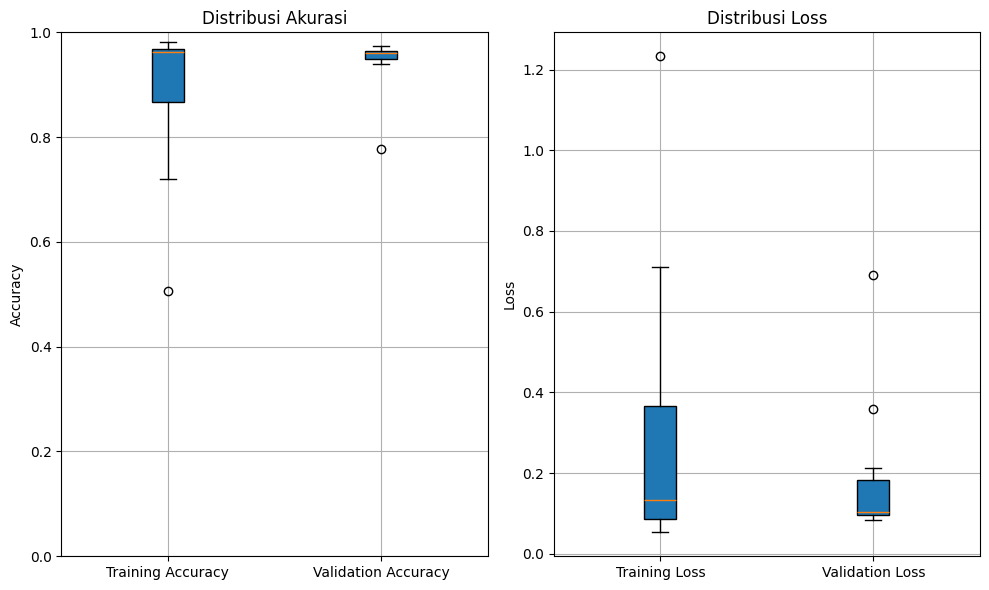

In [12]:
# Tentukan jumlah fold
n_splits = 5
kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

# Direktori untuk menyimpan model terbaik
best_model_dir = r'.\keras' 

# Fungsi untuk membuat model
def create_model(num_classes):
    base_model = DenseNet169(weights='imagenet', include_top=False, input_shape=(IMAGE_WIDTH, IMAGE_HEIGHT, COLOR_CHANNELS))

    for layer in base_model.layers[:-150]:
      layer.trainable = False

    x = base_model.output
    x = Conv2D(32, (4, 4), activation='relu')(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(0.3)(x)
    x = Dense(64, activation='relu', name='FC2')(x) 
    x = Dropout(0.3)(x)
    x = Flatten()(x)
    x = Dropout(0.3)(x)
    
    predictions = Dense(num_classes, activation='softmax')(x)
    model = Model(inputs=base_model.input, outputs=predictions)
    model.compile(optimizer=RMSprop(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])
    
    # Menampilkan jumlah total layer
    print("Total jumlah layer:", len(model.layers))

    print("Total trainable layers:", len([layer for layer in model.layers if layer.trainable]))
    # model.summary()
    return model

EPOCHS = 20
fold_var = 1

# Looping untuk setiap fold
for train_index, val_index in kf.split(file_paths):
    print(f"\n🚀 Training Fold {fold_var} 😌\n")

    # Split train and validation sets
    train_files, val_files = np.array(file_paths)[train_index], np.array(file_paths)[val_index]
    train_labels, val_labels = np.array(integer_labels)[train_index], np.array(integer_labels)[val_index]
    
    # Convert integer labels to class names
    df_train = pd.DataFrame({"filename": train_files, "class": [unique_labels[i] for i in train_labels]})
    df_val = pd.DataFrame({"filename": val_files, "class": [unique_labels[i] for i in val_labels]})


    train_generator = datagen.flow_from_dataframe(
        dataframe=df_train,       # DataFrame yang berisi informasi gambar (filename dan class)
        x_col="filename",         # Kolom yang berisi path ke gambar
        y_col="class",            # Kolom yang berisi label kelas gambar
        target_size=IMAGE_SIZE,   # Ukuran gambar yang akan diubah sebelum masuk ke model
        batch_size=BATCH_SIZE,    # Jumlah gambar yang akan diproses dalam satu batch
        class_mode="categorical", # Mode klasifikasi (multikategori)
        color_mode="rgb",         # Format warna gambar (RGB)
        shuffle=True
    )
    
    val_generator = datagen.flow_from_dataframe(
        dataframe=df_val,
        x_col="filename",
        y_col="class",
        target_size=IMAGE_SIZE,
        batch_size=BATCH_SIZE,
        class_mode="categorical",
        color_mode="rgb",
        shuffle=True
    )

    # Callbacks
    early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True, verbose=1)
    model_checkpoint = ModelCheckpoint(os.path.join(best_model_dir, f'150_model_{fold_var}.keras'), monitor='val_loss', save_best_only=True)
    
    # Buat Learning Rate Scheduler
    lr_scheduler = ReduceLROnPlateau(
        monitor='val_accuracy',     
        factor=0.1,             
        patience=3,             # Jika val_loss tidak membaik setelah 3 epoch, LR akan diturunkan
        min_lr=1e-6,            
        verbose=1               
    )

    num_classes = 4
    model = create_model(num_classes)

    # Training Model
    history = model.fit(
        train_generator,
        epochs=EPOCHS,
        validation_data=val_generator,
        callbacks=[early_stopping, model_checkpoint, lr_scheduler]
    )

    # Plot grafik akurasi dan loss dengan format yang lebih baik
    plt.figure(figsize=(14, 6))

    # Plot Training and Validation Accuracy
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Training Accuracy', marker='o')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy', marker='o')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.ylim(0, 1)  # Menentukan rentang y antara 0 dan 1 (untuk akurasi)
    plt.grid(True)
    plt.legend()

    # Plot Training and Validation Loss
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Training Loss', marker='o')
    plt.plot(history.history['val_loss'], label='Validation Loss', marker='o')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.grid(True)
    plt.legend()

    # Buat figure Box Plot
    plt.figure(figsize=(10, 6))
    
    # Boxplot untuk Training & Validation Accuracy
    plt.subplot(1, 2, 1)
    plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
                labels=['Training Accuracy', 'Validation Accuracy'])
    plt.title('Distribusi Akurasi')
    plt.ylabel('Accuracy')
    plt.ylim(0, 1)
    plt.grid(True)
    
    # Boxplot untuk Training & Validation Loss
    plt.subplot(1, 2, 2)
    plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,
                labels=['Training Loss', 'Validation Loss'])
    plt.title('Distribusi Loss')
    plt.ylabel('Loss')
    plt.grid(True)

    # Tampilkan grafik
    plt.tight_layout()
    plt.show()

    # menambah fold
    fold_var += 1

In [18]:
import numpy as np

# Contoh hasil akurasi dari 5 fold
accuracies = [95.24, 95.67, 95.65, 96.09, 97.39]

# Menghitung standar deviasi
std_dev = np.std(accuracies)

print(f"Standar Deviasi Akurasi Model P2: {std_dev:.4f}")



Standar Deviasi Akurasi Model P2: 0.7415


In [17]:
loaded_model = load_model('./keras/rms_coba_lagi.keras')

predictions = loaded_model.predict(test_generator)

  # Get class labels
class_labels = list(test_generator.class_indices.keys())

  # Get the true class indices
true_class_indices = test_generator.classes

  # Get the predicted class indices
predicted_class_indices = np.argmax(predictions, axis=1)

  # Map predicted class indices to the actual class labels
predicted_labels = [class_labels[idx] for idx in predicted_class_indices]

  # Calculate the prediction confidence for each image
prediction_confidences = np.max(predictions, axis=1)

y_true = test_generator.classes
y_pred = np.argmax(predictions, axis=1)

  # Confusion Matrix Display
conf_matrix = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=class_labels)

disp.plot(cmap='viridis')
plt.title('Confusion Matrix')
plt.xticks(rotation=85)
plt.show()

class_report = classification_report(y_true, y_pred, target_names=class_labels, digits=4)
print('Classification Report')
print(class_report)


ValueError: File not found: filepath=./keras/rms_coba_lagi.keras. Please ensure the file is an accessible `.keras` zip file.

In [55]:
def create_model(num_classes):
    base_model = DenseNet169(weights='imagenet', include_top=False, input_shape=(IMAGE_WIDTH, IMAGE_HEIGHT, COLOR_CHANNELS))

    for layer in base_model.layers[:-10]:  # Membekukan semua kecuali 10 lapisan terakhir
        layer.trainable = False 

    x = base_model.output
    x = Conv2D(32, (4, 4), activation='relu')(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(0.3)(x)
    x = Dense(64, activation='relu', name='FC2')(x) 
    x = Dropout(0.3)(x)
    x = Flatten()(x)
    x = Dropout(0.3)(x)
    predictions = Dense(num_classes, activation='softmax')(x)
    model = Model(inputs=base_model.input, outputs=predictions)
    model.compile(optimizer=RMSprop(0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

    # menampilkan total layer train yang digunakan pada densenet169
    print("TOTAL TRAINABLE: ", len([layer for layer in base_model.layers if layer.trainable],), "\n")


    # layer 10 terakhir yang di train
    if len(model.layers) >= 10:
        last_10_layers = model.layers[-19:-9]  

        for i, layer in enumerate(last_10_layers):
            print(f"Layer {i+1}:")
            print(f"  Nama Layer     : {layer.name}")
            print(f"  Tipe Layer     : {type(layer)}")
            print(f"  Trainable      : {layer.trainable}")
            print(f"  Konfigurasi    : {layer.get_config()}")
            print("-" * 50)
    else:
        print("Model memiliki kurang dari 10 layer. Tidak dapat mengambil 10 layer terakhir.")


    # check satu-satu [conv1, conv2, conv3, conv4, conv5, pool1, pool2, pool3, pool4]
    total_layer = 0
    for layer in model.layers:
        if "conv1" in layer.name:
            print("name: ", layer.name)
            total_layer += 1
    print("total Conv1: ", total_layer, "\n")


    # menampilkan total dari setiap layer densenet169
    dense_blocks = {"Conv1": 0, "Dense Block 1": 0, "Transition 1": 0, 
                    "Dense Block 2": 0, "Transition 2": 0, "Dense Block 3": 0,
                    "Transition 3": 0, "Dense Block 4": 0, "Classification Head": 0}

    for layer in model.layers:
        name = layer.name
        if "conv1" in name:
            dense_blocks["Conv1"] += 1
        elif "conv2" in name or "dense_block1" in name:
            dense_blocks["Dense Block 1"] += 1
        elif "pool2" in name or "transition1" in name:
            dense_blocks["Transition 1"] += 1
        elif "conv3" in name or "dense_block2" in name:
            dense_blocks["Dense Block 2"] += 1
        elif "pool3" in name or "transition2" in name:
            dense_blocks["Transition 2"] += 1
        elif "conv4" in name or "dense_block3" in name:
            dense_blocks["Dense Block 3"] += 1
        elif "pool4" in name or "transition3" in name:
            dense_blocks["Transition 3"] += 1
        elif "conv5" in name or "dense_block4" in name:
            dense_blocks["Dense Block 4"] += 1
        else:
            dense_blocks["Classification Head"] += 1

    for key, value in dense_blocks.items():
        print(f"{key}: {value} layers")
    print(f"\nTOTAL LAYER DENSENET169: {len(model.layers)} \n")
    

    # model.summary()
    return model

# Direktori untuk menyimpan model terbaik
best_model_dir = r'.\keras' # Mendefinisikan best_model_dir di luar fungsi
os.makedirs(best_model_dir, exist_ok=True)

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True, verbose=1)
model_checkpoint = ModelCheckpoint(os.path.join(best_model_dir, 'rms_coba.keras'), monitor='val_accuracy', save_best_only=True)

    # Buat Learning Rate Scheduler
lr_scheduler = ReduceLROnPlateau(
    monitor='val_accuracy',  # Memonitor val_acc untuk menurunkan LR
    factor=0.1,             # Learning rate akan dikalikan 0.5 jika tidak ada perbaikan
    patience=3,             # Jika val_acc tidak membaik setelah 4 epoch, LR akan diturunkan
    min_lr=1e-6,            # Learning rate minimum
    verbose=1               # Menampilkan log saat LR diturunkan
)

num_classes = len(labels) # atau bagaimanapun Anda menentukan jumlah kelas
model = create_model(num_classes) # Panggil fungsi create_model dengan jumlah kelas yang benar

train_generator = datagen.flow_from_directory(
    directory=train_dir,
    target_size=IMAGE_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    subset='training',
    shuffle=True
)

val_generator = datagen.flow_from_directory(
    directory=train_dir,
    target_size=IMAGE_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    subset='validation',
    shuffle=True
)

# Training model tanpa KFold
EPOCHS = 20  # Ubah jumlah epoch menjadi 20
history = model.fit(
    train_generator,
    epochs=EPOCHS,
    validation_data=val_generator,
    callbacks=[early_stopping, model_checkpoint, lr_scheduler]
)

# Plot grafik akurasi dan loss dengan format yang lebih baik
plt.figure(figsize=(14, 6))

# Plot Training and Validation Accuracy
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Training Accuracy', marker='o')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy', marker='o')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim(0, 1)  # Menentukan rentang y antara 0 dan 1 (untuk akurasi)
plt.grid(True)
plt.legend()

# Plot Training and Validation Loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Training Loss', marker='o')
plt.plot(history.history['val_loss'], label='Validation Loss', marker='o')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.grid(True)
plt.legend()


# Buat figure Box Plot
plt.figure(figsize=(10, 6))

# Boxplot untuk Training & Validation Accuracy
plt.subplot(1, 2, 1)
plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
            labels=['Training Accuracy', 'Validation Accuracy'])
plt.title('Distribusi Akurasi')
plt.ylabel('Accuracy')
plt.ylim(0, 1)
plt.grid(True)

# Boxplot untuk Training & Validation Loss
plt.subplot(1, 2, 2)
plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,
            labels=['Training Loss', 'Validation Loss'])
plt.title('Distribusi Loss')
plt.ylabel('Loss')
plt.grid(True)


# Tampilkan grafik
plt.tight_layout()
plt.show()

TOTAL TRAINABLE:  10 

Layer 1:
  Nama Layer     : conv5_block31_2_conv
  Tipe Layer     : <class 'keras.src.layers.convolutional.conv2d.Conv2D'>
  Trainable      : False
  Konfigurasi    : {'name': 'conv5_block31_2_conv', 'trainable': False, 'dtype': {'module': 'keras', 'class_name': 'DTypePolicy', 'config': {'name': 'float32'}, 'registered_name': None}, 'filters': 32, 'kernel_size': (3, 3), 'strides': (1, 1), 'padding': 'same', 'data_format': 'channels_last', 'dilation_rate': (1, 1), 'groups': 1, 'activation': 'linear', 'use_bias': False, 'kernel_initializer': {'module': 'keras.initializers', 'class_name': 'GlorotUniform', 'config': {'seed': None}, 'registered_name': None}, 'bias_initializer': {'module': 'keras.initializers', 'class_name': 'Zeros', 'config': {}, 'registered_name': None}, 'kernel_regularizer': None, 'bias_regularizer': None, 'activity_regularizer': None, 'kernel_constraint': None, 'bias_constraint': None}
--------------------------------------------------
Layer 2:
  N

KeyboardInterrupt: 

9/9 ━━━━━━━━━━━━━━━━━━━━ 33s 3s/step


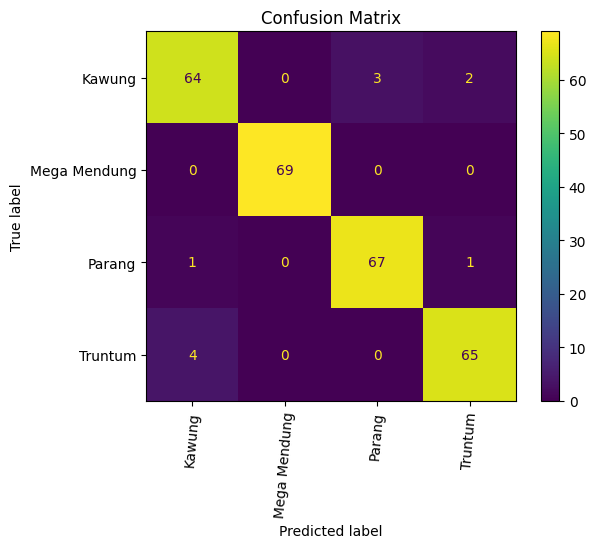

Classification Report
              precision    recall  f1-score   support

      Kawung     0.9275    0.9275    0.9275        69
Mega Mendung     1.0000    1.0000    1.0000        69
      Parang     0.9571    0.9710    0.9640        69
     Truntum     0.9559    0.9420    0.9489        69

    accuracy                         0.9601       276
   macro avg     0.9601    0.9601    0.9601       276
weighted avg     0.9601    0.9601    0.9601       276



In [ ]:
loaded_model = load_model('./keras/rms_coba.keras')

predictions = loaded_model.predict(test_generator)

  # Get class labels
class_labels = list(test_generator.class_indices.keys())

  # Get the true class indices
true_class_indices = test_generator.classes

  # Get the predicted class indices
predicted_class_indices = np.argmax(predictions, axis=1)

  # Map predicted class indices to the actual class labels
predicted_labels = [class_labels[idx] for idx in predicted_class_indices]

  # Calculate the prediction confidence for each image
prediction_confidences = np.max(predictions, axis=1)

y_true = test_generator.classes
y_pred = np.argmax(predictions, axis=1)

  # Confusion Matrix Display
conf_matrix = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=class_labels)

disp.plot(cmap='viridis')
plt.title('Confusion Matrix')
plt.xticks(rotation=85)
plt.show()

class_report = classification_report(y_true, y_pred, target_names=class_labels, digits=4)
print('Classification Report')
print(class_report)

## coba model conv5 50


🚀 Training Fold 1 😌

Found 921 validated image filenames belonging to 4 classes.
Found 231 validated image filenames belonging to 4 classes.
Total jumlah layer: 603
Total trainable layers: 58


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 161s 5s/step - accuracy: 0.4335 - loss: 1.4149 - val_accuracy: 0.8571 - val_loss: 0.5635 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 116s 4s/step - accuracy: 0.7099 - loss: 0.7261 - val_accuracy: 0.9048 - val_loss: 0.3383 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 110s 4s/step - accuracy: 0.8121 - loss: 0.4670 - val_accuracy: 0.9437 - val_loss: 0.2441 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 110s 4s/step - accuracy: 0.8505 - loss: 0.3944 - val_accuracy: 0.9351 - val_loss: 0.2078 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 110s 4s/step - accuracy: 0.8737 - loss: 0.3389 - val_accuracy: 0.9264 - val_loss: 0.1779 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 105s 4s/step - accuracy: 0.9476 - loss: 0.1861 - val_accuracy: 0.9524 - val_loss: 0.1446 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 113s 4s/step - accuracy: 0.9285 

C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\1391721414.py:126: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\1391721414.py:135: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


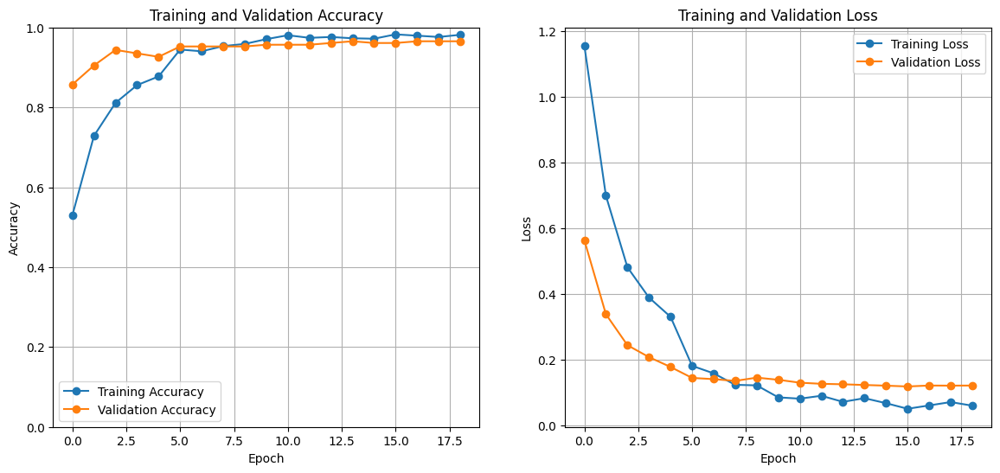

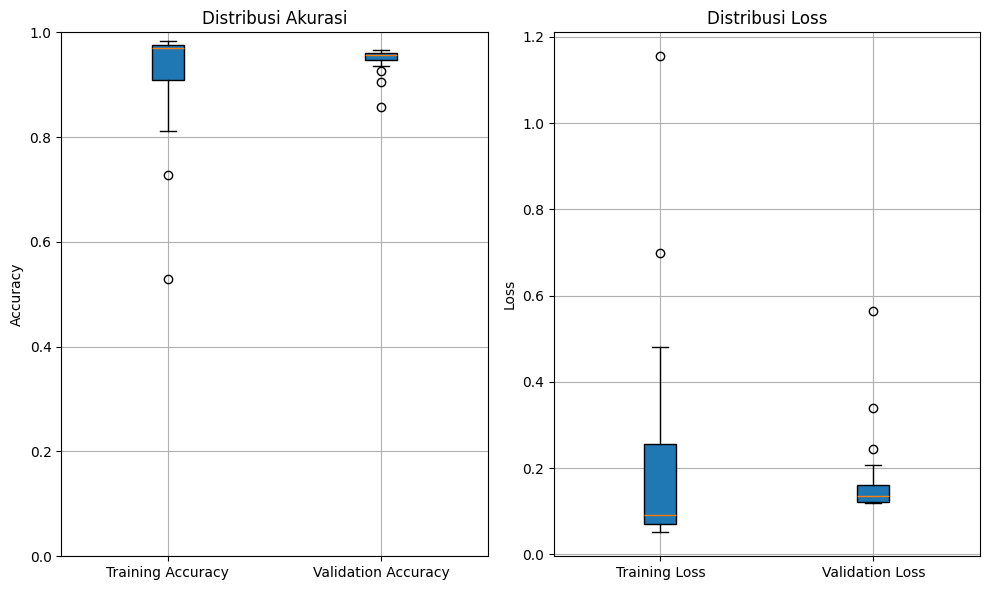


🚀 Training Fold 2 😌

Found 921 validated image filenames belonging to 4 classes.
Found 231 validated image filenames belonging to 4 classes.
Total jumlah layer: 603
Total trainable layers: 58


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 151s 4s/step - accuracy: 0.4265 - loss: 1.3917 - val_accuracy: 0.8961 - val_loss: 0.5544 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 99s 3s/step - accuracy: 0.7812 - loss: 0.5925 - val_accuracy: 0.9481 - val_loss: 0.3117 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 96s 3s/step - accuracy: 0.8514 - loss: 0.4240 - val_accuracy: 0.9610 - val_loss: 0.1954 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 96s 3s/step - accuracy: 0.8960 - loss: 0.2684 - val_accuracy: 0.9567 - val_loss: 0.1406 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 96s 3s/step - accuracy: 0.9058 - loss: 0.2285 - val_accuracy: 0.9610 - val_loss: 0.1145 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 95s 3s/step - accuracy: 0.9296 - loss: 0.2036 - val_accuracy: 0.9654 - val_loss: 0.0894 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 95s 3s/step - accuracy: 0.9518 - loss

C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\1391721414.py:126: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\1391721414.py:135: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


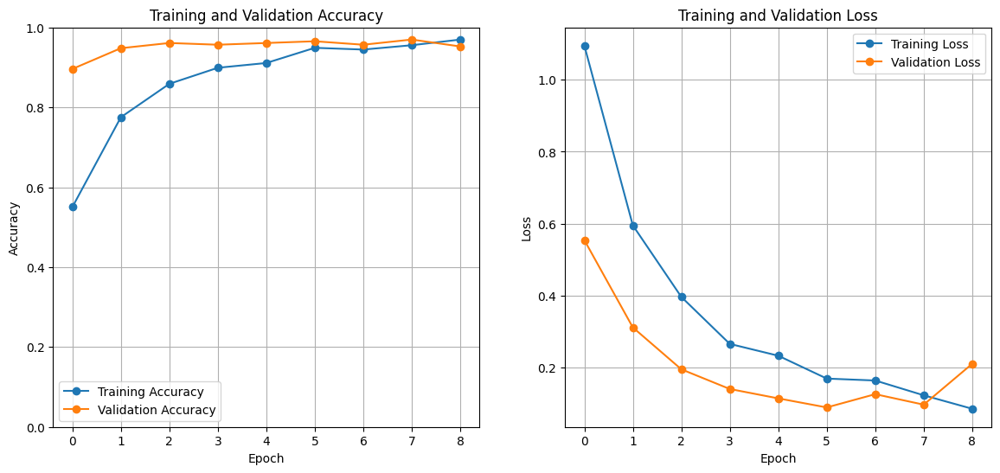

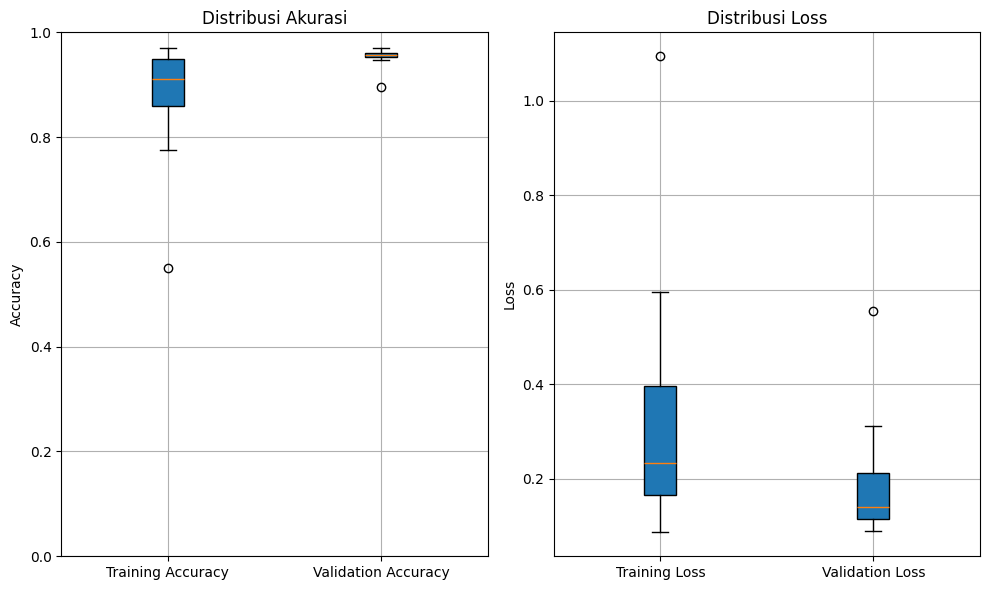


🚀 Training Fold 3 😌

Found 922 validated image filenames belonging to 4 classes.
Found 230 validated image filenames belonging to 4 classes.
Total jumlah layer: 603
Total trainable layers: 58


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 150s 4s/step - accuracy: 0.4182 - loss: 1.5008 - val_accuracy: 0.8130 - val_loss: 0.7479 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 99s 3s/step - accuracy: 0.6098 - loss: 0.9225 - val_accuracy: 0.8783 - val_loss: 0.4662 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 94s 3s/step - accuracy: 0.7531 - loss: 0.6443 - val_accuracy: 0.9217 - val_loss: 0.3377 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 94s 3s/step - accuracy: 0.8487 - loss: 0.4312 - val_accuracy: 0.9261 - val_loss: 0.2515 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 96s 3s/step - accuracy: 0.8749 - loss: 0.3356 - val_accuracy: 0.9435 - val_loss: 0.2082 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 99s 3s/step - accuracy: 0.9273 - loss: 0.2062 - val_accuracy: 0.9435 - val_loss: 0.1996 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 92s 3s/step - accuracy: 0.9372 - loss

C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\1391721414.py:126: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\1391721414.py:135: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


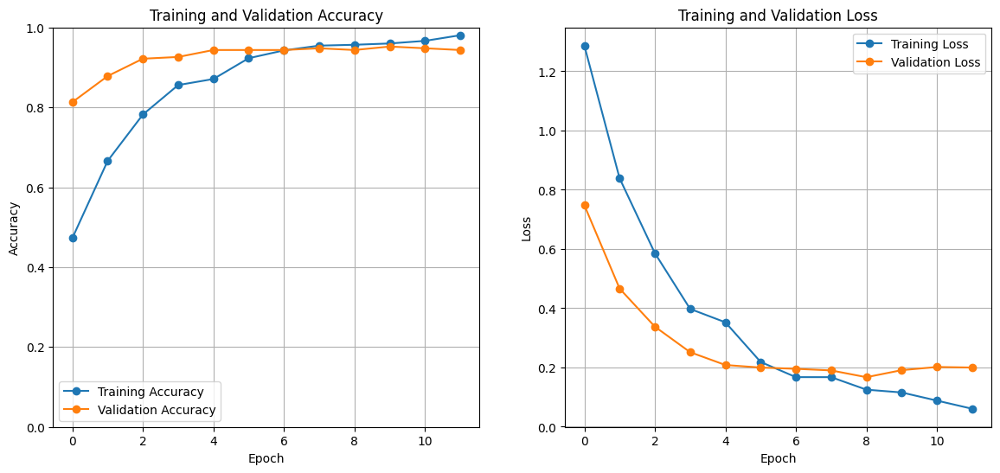

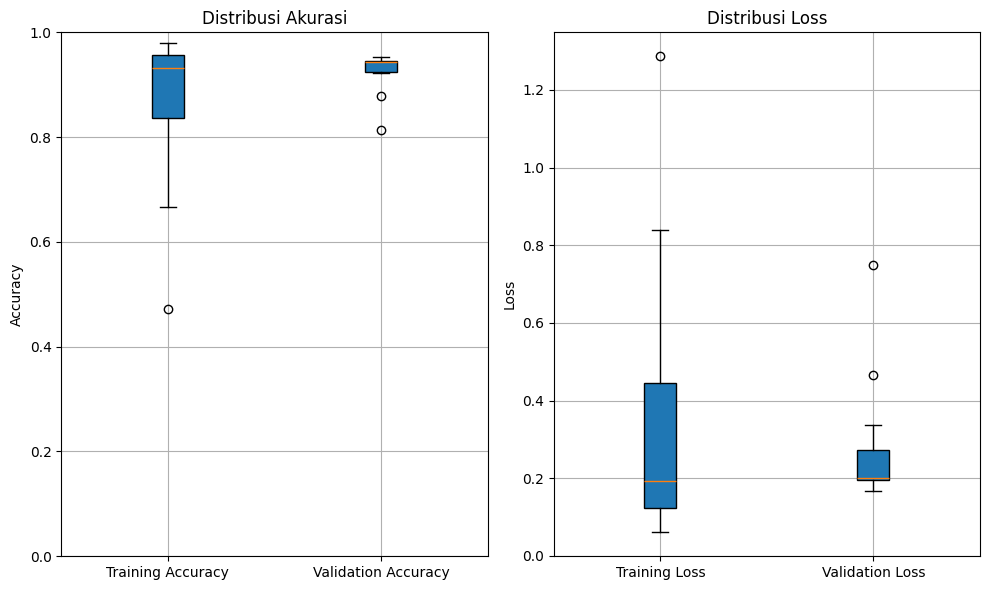


🚀 Training Fold 4 😌

Found 922 validated image filenames belonging to 4 classes.
Found 230 validated image filenames belonging to 4 classes.
Total jumlah layer: 603
Total trainable layers: 58


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 124s 4s/step - accuracy: 0.3686 - loss: 1.5973 - val_accuracy: 0.8000 - val_loss: 0.7203 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 107s 4s/step - accuracy: 0.6805 - loss: 0.7598 - val_accuracy: 0.8957 - val_loss: 0.4890 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 99s 3s/step - accuracy: 0.7792 - loss: 0.5711 - val_accuracy: 0.9043 - val_loss: 0.3251 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 107s 4s/step - accuracy: 0.8178 - loss: 0.4670 - val_accuracy: 0.9304 - val_loss: 0.2376 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 98s 3s/step - accuracy: 0.9031 - loss: 0.2994 - val_accuracy: 0.9217 - val_loss: 0.2252 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 91s 3s/step - accuracy: 0.9133 - loss: 0.2397 - val_accuracy: 0.9304 - val_loss: 0.1878 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 90s 3s/step - accuracy: 0.9355 - lo

C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\1391721414.py:126: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\1391721414.py:135: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


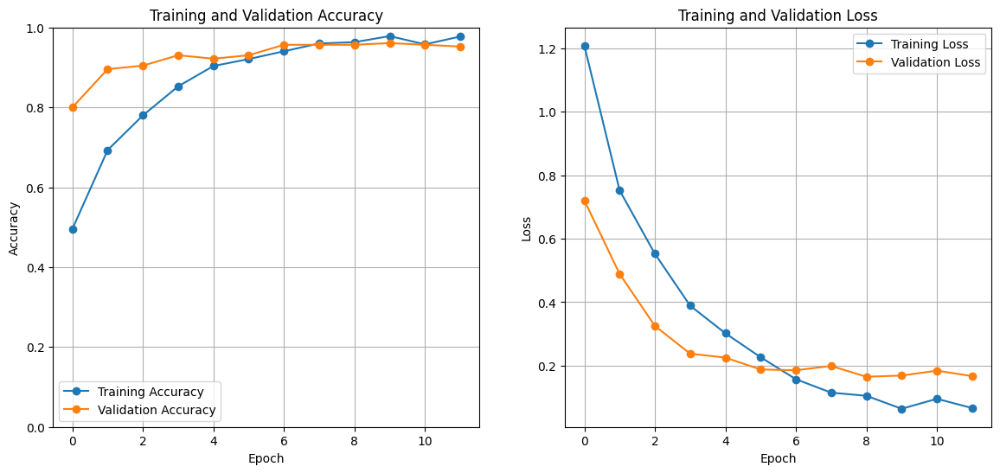

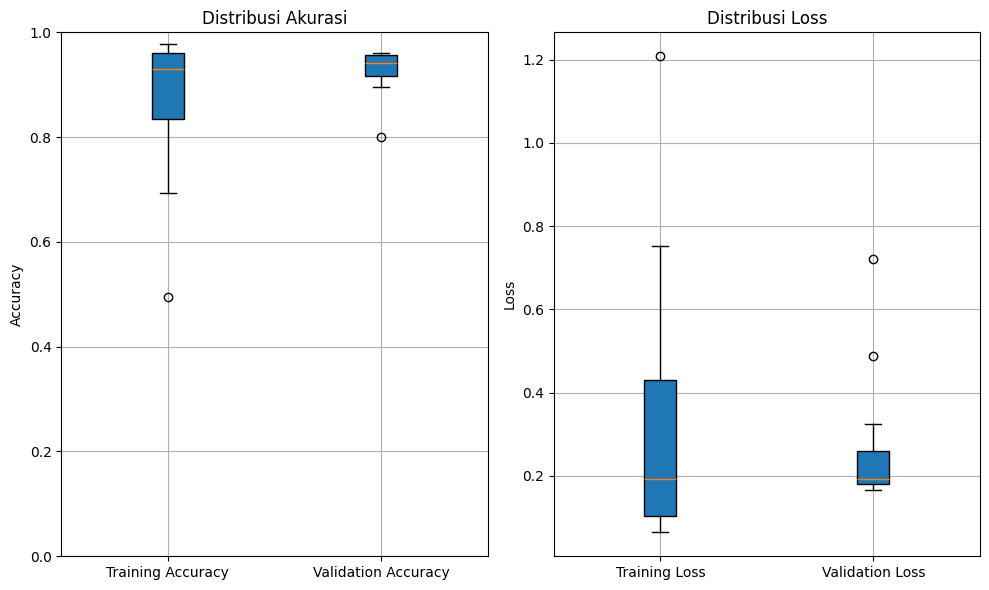


🚀 Training Fold 5 😌

Found 922 validated image filenames belonging to 4 classes.
Found 230 validated image filenames belonging to 4 classes.
Total jumlah layer: 603
Total trainable layers: 58


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 130s 4s/step - accuracy: 0.4609 - loss: 1.3675 - val_accuracy: 0.8826 - val_loss: 0.5477 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 103s 4s/step - accuracy: 0.7390 - loss: 0.6400 - val_accuracy: 0.9565 - val_loss: 0.2798 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 103s 4s/step - accuracy: 0.8391 - loss: 0.4252 - val_accuracy: 0.9478 - val_loss: 0.2129 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 102s 4s/step - accuracy: 0.8667 - loss: 0.3272 - val_accuracy: 0.9652 - val_loss: 0.1436 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 103s 4s/step - accuracy: 0.9101 - loss: 0.2390 - val_accuracy: 0.9652 - val_loss: 0.1366 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 102s 4s/step - accuracy: 0.9459 - loss: 0.1505 - val_accuracy: 0.9565 - val_loss: 0.1438 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9536 - 

C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\1391721414.py:126: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_15964\1391721414.py:135: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


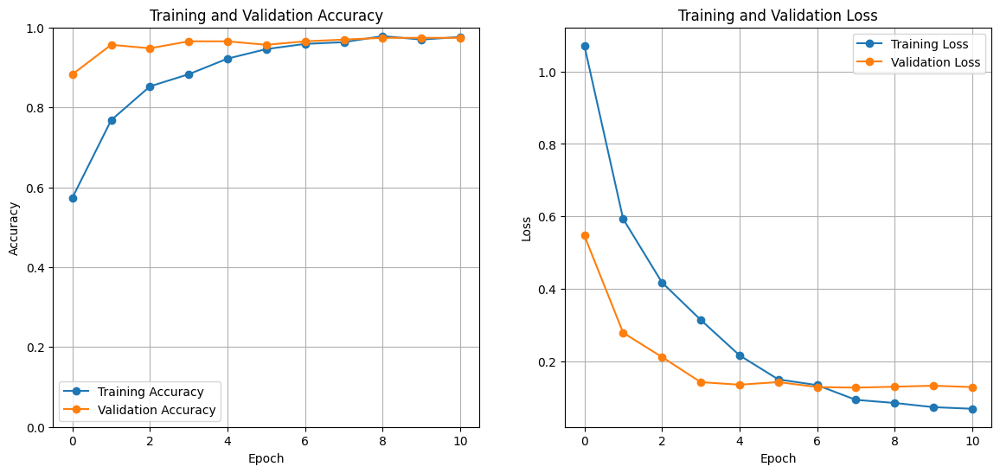

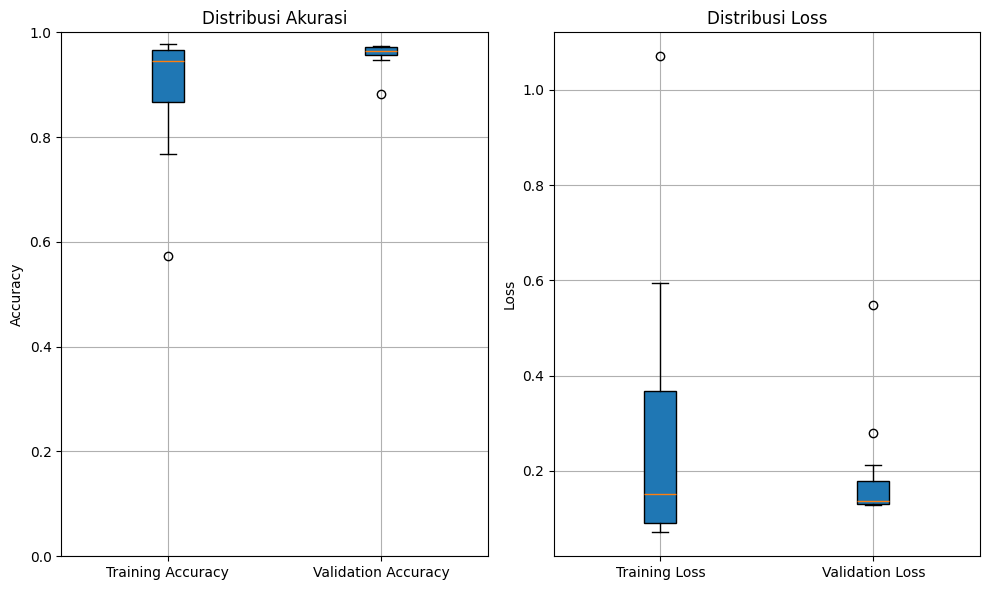

In [20]:
# Tentukan jumlah fold
n_splits = 5
kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

# Direktori untuk menyimpan model terbaik
best_model_dir = r'.\keras' 

# Fungsi untuk membuat model
def create_model(num_classes):
    base_model = DenseNet169(weights='imagenet', include_top=False, input_shape=(IMAGE_WIDTH, IMAGE_HEIGHT, COLOR_CHANNELS))

    for layer in base_model.layers[:-50]:
      layer.trainable = False

    x = base_model.output
    x = Conv2D(32, (4, 4), activation='relu')(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(0.3)(x)
    x = Dense(64, activation='relu', name='FC2')(x) 
    x = Dropout(0.3)(x)
    x = Flatten()(x)
    x = Dropout(0.3)(x)
    
    predictions = Dense(num_classes, activation='softmax')(x)
    model = Model(inputs=base_model.input, outputs=predictions)
    model.compile(optimizer=RMSprop(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])
    
    # Menampilkan jumlah total layer
    print("Total jumlah layer:", len(model.layers))

    print("Total trainable layers:", len([layer for layer in model.layers if layer.trainable]))
    # model.summary()
    return model

EPOCHS = 20
fold_var = 1

# Looping untuk setiap fold
for train_index, val_index in kf.split(file_paths):
    print(f"\n🚀 Training Fold {fold_var} 😌\n")

    # Split train and validation sets
    train_files, val_files = np.array(file_paths)[train_index], np.array(file_paths)[val_index]
    train_labels, val_labels = np.array(integer_labels)[train_index], np.array(integer_labels)[val_index]
    
    # Convert integer labels to class names
    df_train = pd.DataFrame({"filename": train_files, "class": [unique_labels[i] for i in train_labels]})
    df_val = pd.DataFrame({"filename": val_files, "class": [unique_labels[i] for i in val_labels]})


    train_generator = datagen.flow_from_dataframe(
        dataframe=df_train,       # DataFrame yang berisi informasi gambar (filename dan class)
        x_col="filename",         # Kolom yang berisi path ke gambar
        y_col="class",            # Kolom yang berisi label kelas gambar
        target_size=IMAGE_SIZE,   # Ukuran gambar yang akan diubah sebelum masuk ke model
        batch_size=BATCH_SIZE,    # Jumlah gambar yang akan diproses dalam satu batch
        class_mode="categorical", # Mode klasifikasi (multikategori)
        color_mode="rgb",         # Format warna gambar (RGB)
        shuffle=True
    )
    
    val_generator = datagen.flow_from_dataframe(
        dataframe=df_val,
        x_col="filename",
        y_col="class",
        target_size=IMAGE_SIZE,
        batch_size=BATCH_SIZE,
        class_mode="categorical",
        color_mode="rgb",
        shuffle=True
    )

    # Callbacks
    early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True, verbose=1)
    model_checkpoint = ModelCheckpoint(os.path.join(best_model_dir, f'50_model_{fold_var}.keras'), monitor='val_loss', save_best_only=True)
    
    # Buat Learning Rate Scheduler
    lr_scheduler = ReduceLROnPlateau(
        monitor='val_accuracy',     
        factor=0.1,             
        patience=3,             # Jika val_loss tidak membaik setelah 3 epoch, LR akan diturunkan
        min_lr=1e-6,            
        verbose=1               
    )

    num_classes = 4
    model = create_model(num_classes)

    # Training Model
    history = model.fit(
        train_generator,
        epochs=EPOCHS,
        validation_data=val_generator,
        callbacks=[early_stopping, model_checkpoint, lr_scheduler]
    )

    # Plot grafik akurasi dan loss dengan format yang lebih baik
    plt.figure(figsize=(14, 6))

    # Plot Training and Validation Accuracy
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Training Accuracy', marker='o')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy', marker='o')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.ylim(0, 1)  # Menentukan rentang y antara 0 dan 1 (untuk akurasi)
    plt.grid(True)
    plt.legend()

    # Plot Training and Validation Loss
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Training Loss', marker='o')
    plt.plot(history.history['val_loss'], label='Validation Loss', marker='o')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.grid(True)
    plt.legend()

    # Buat figure Box Plot
    plt.figure(figsize=(10, 6))
    
    # Boxplot untuk Training & Validation Accuracy
    plt.subplot(1, 2, 1)
    plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
                labels=['Training Accuracy', 'Validation Accuracy'])
    plt.title('Distribusi Akurasi')
    plt.ylabel('Accuracy')
    plt.ylim(0, 1)
    plt.grid(True)
    
    # Boxplot untuk Training & Validation Loss
    plt.subplot(1, 2, 2)
    plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,
                labels=['Training Loss', 'Validation Loss'])
    plt.title('Distribusi Loss')
    plt.ylabel('Loss')
    plt.grid(True)

    # Tampilkan grafik
    plt.tight_layout()
    plt.show()

    # menambah fold
    fold_var += 1

In [22]:
import numpy as np

# Contoh hasil akurasi dari 5 fold
accuracies = [96.10, 96.54, 94.35, 95.65, 96.96]

# Menghitung standar deviasi
std_dev = np.std(accuracies)

print(f"Standar Deviasi Akurasi Model train 50 layer: {std_dev:.4f}")


Standar Deviasi Akurasi Model train 50 layer: 0.8985


## coba model membekukan semuanya

In [ ]:
# Tentukan jumlah fold
n_splits = 5
kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

# Direktori untuk menyimpan model terbaik
best_model_dir = r'.\keras' 

# Fungsi untuk membuat model
def create_model(num_classes):
    base_model = DenseNet169(weights='imagenet', include_top=False, input_shape=(IMAGE_WIDTH, IMAGE_HEIGHT, COLOR_CHANNELS))

    base_model.trainable = False

    x = base_model.output
    x = Conv2D(32, (4, 4), activation='relu')(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(0.3)(x)
    x = Dense(64, activation='relu', name='FC2')(x) 
    x = Dropout(0.3)(x)
    x = Flatten()(x)
    x = Dropout(0.3)(x)
    
    predictions = Dense(num_classes, activation='softmax')(x)
    model = Model(inputs=base_model.input, outputs=predictions)
    model.compile(optimizer=RMSprop(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])
    
    # Menampilkan jumlah total layer
    print("Total jumlah layer:", len(model.layers))

    print("Total trainable layers:", len([layer for layer in model.layers if layer.trainable]))

    return model

EPOCHS = 20
fold_var = 1

# Looping untuk setiap fold
for train_index, val_index in kf.split(file_paths):
    print(f"\n🚀 Training Fold {fold_var} 😌\n")

    # Split train and validation sets
    train_files, val_files = np.array(file_paths)[train_index], np.array(file_paths)[val_index]
    train_labels, val_labels = np.array(integer_labels)[train_index], np.array(integer_labels)[val_index]
    
    # Convert integer labels to class names
    df_train = pd.DataFrame({"filename": train_files, "class": [unique_labels[i] for i in train_labels]})
    df_val = pd.DataFrame({"filename": val_files, "class": [unique_labels[i] for i in val_labels]})


    train_generator = datagen.flow_from_dataframe(
        dataframe=df_train,       # DataFrame yang berisi informasi gambar (filename dan class)
        x_col="filename",         # Kolom yang berisi path ke gambar
        y_col="class",            # Kolom yang berisi label kelas gambar
        target_size=IMAGE_SIZE,   # Ukuran gambar yang akan diubah sebelum masuk ke model
        batch_size=BATCH_SIZE,    # Jumlah gambar yang akan diproses dalam satu batch
        class_mode="categorical", # Mode klasifikasi (multikategori)
        color_mode="rgb",         # Format warna gambar (RGB)
        shuffle=True
    )
    
    val_generator = datagen.flow_from_dataframe(
        dataframe=df_val,
        x_col="filename",
        y_col="class",
        target_size=IMAGE_SIZE,
        batch_size=BATCH_SIZE,
        class_mode="categorical",
        color_mode="rgb",
        shuffle=True
    )

    # Callbacks
    early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True, verbose=1)
    model_checkpoint = ModelCheckpoint(os.path.join(best_model_dir, f'50_model_{fold_var}.keras'), monitor='val_loss', save_best_only=True)
    
    # Buat Learning Rate Scheduler
    lr_scheduler = ReduceLROnPlateau(
        monitor='val_accuracy',     
        factor=0.1,             
        patience=3,             # Jika val_loss tidak membaik setelah 3 epoch, LR akan diturunkan
        min_lr=1e-6,            
        verbose=1               
    )

    num_classes = 4
    model = create_model(num_classes)

    # Training Model
    history = model.fit(
        train_generator,
        epochs=EPOCHS,
        validation_data=val_generator,
        callbacks=[early_stopping, model_checkpoint, lr_scheduler]
    )

    # Plot grafik akurasi dan loss dengan format yang lebih baik
    plt.figure(figsize=(14, 6))

    # Plot Training and Validation Accuracy
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Training Accuracy', marker='o')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy', marker='o')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.ylim(0, 1)  # Menentukan rentang y antara 0 dan 1 (untuk akurasi)
    plt.grid(True)
    plt.legend()

    # Plot Training and Validation Loss
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Training Loss', marker='o')
    plt.plot(history.history['val_loss'], label='Validation Loss', marker='o')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.grid(True)
    plt.legend()

    # Buat figure Box Plot
    plt.figure(figsize=(10, 6))
    
    # Boxplot untuk Training & Validation Accuracy
    plt.subplot(1, 2, 1)
    plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
                labels=['Training Accuracy', 'Validation Accuracy'])
    plt.title('Distribusi Akurasi')
    plt.ylabel('Accuracy')
    plt.ylim(0, 1)
    plt.grid(True)
    
    # Boxplot untuk Training & Validation Loss
    plt.subplot(1, 2, 2)
    plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,
                labels=['Training Loss', 'Validation Loss'])
    plt.title('Distribusi Loss')
    plt.ylabel('Loss')
    plt.grid(True)

    # Tampilkan grafik
    plt.tight_layout()
    plt.show()

    # menambah fold
    fold_var += 1

## Kfold Perbandingan


🚀 Training Fold 1 😌

Found 921 validated image filenames belonging to 4 classes.
Found 231 validated image filenames belonging to 4 classes.


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 116s 3s/step - accuracy: 0.3338 - loss: 1.4990 - val_accuracy: 0.7792 - val_loss: 0.8384 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 90s 3s/step - accuracy: 0.5479 - loss: 0.9978 - val_accuracy: 0.8571 - val_loss: 0.6359 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 88s 3s/step - accuracy: 0.6619 - loss: 0.8105 - val_accuracy: 0.9134 - val_loss: 0.4150 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 90s 3s/step - accuracy: 0.7527 - loss: 0.6264 - val_accuracy: 0.9048 - val_loss: 0.3041 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 89s 3s/step - accuracy: 0.7929 - loss: 0.5401 - val_accuracy: 0.9134 - val_loss: 0.2687 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 90s 3s/step - accuracy: 0.8482 - loss: 0.4300 - val_accuracy: 0.9437 - val_loss: 0.2287 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 89s 3s/step - accuracy: 0.8710 - loss

C:\Users\ASUS\AppData\Local\Temp\ipykernel_16504\4194638042.py:122: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_16504\4194638042.py:131: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


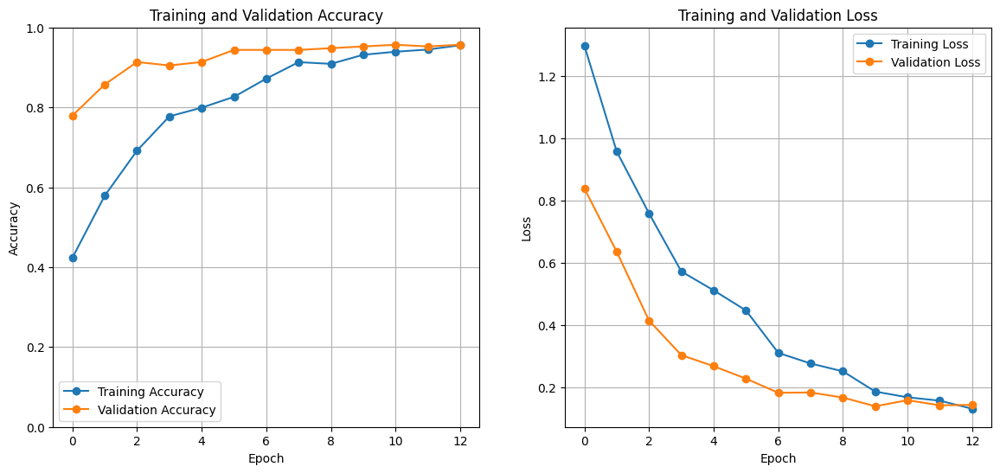

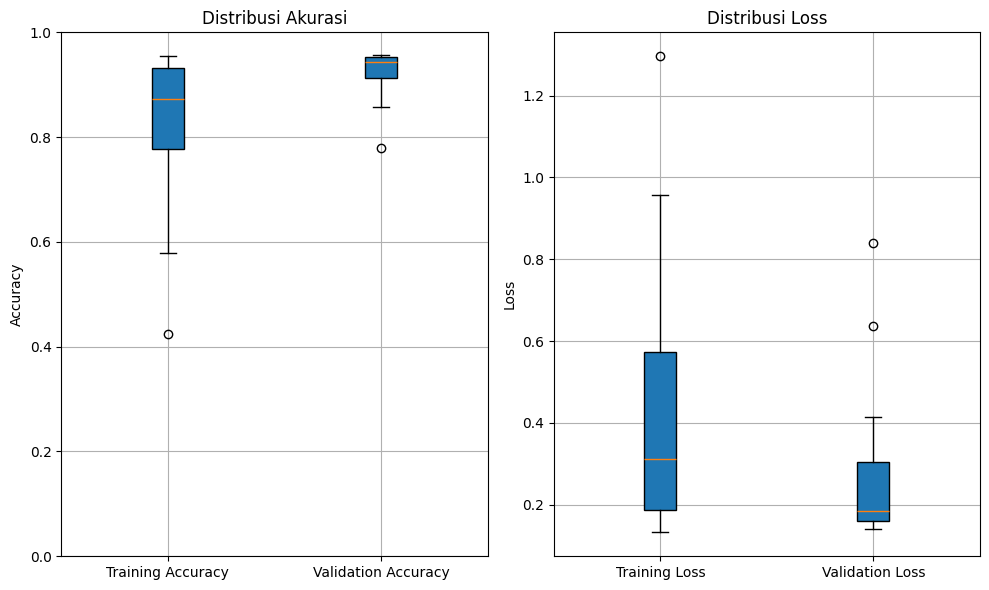


🚀 Training Fold 2 😌

Found 921 validated image filenames belonging to 4 classes.
Found 231 validated image filenames belonging to 4 classes.


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 115s 3s/step - accuracy: 0.4177 - loss: 1.4701 - val_accuracy: 0.8528 - val_loss: 0.7131 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 88s 3s/step - accuracy: 0.6641 - loss: 0.8661 - val_accuracy: 0.9004 - val_loss: 0.4609 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 90s 3s/step - accuracy: 0.7674 - loss: 0.6391 - val_accuracy: 0.9307 - val_loss: 0.3022 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 90s 3s/step - accuracy: 0.7982 - loss: 0.4943 - val_accuracy: 0.9524 - val_loss: 0.2324 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 89s 3s/step - accuracy: 0.8481 - loss: 0.4163 - val_accuracy: 0.9437 - val_loss: 0.1878 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 88s 3s/step - accuracy: 0.8773 - loss: 0.3564 - val_accuracy: 0.9481 - val_loss: 0.1722 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.9023 - loss:

C:\Users\ASUS\AppData\Local\Temp\ipykernel_16504\4194638042.py:122: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_16504\4194638042.py:131: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


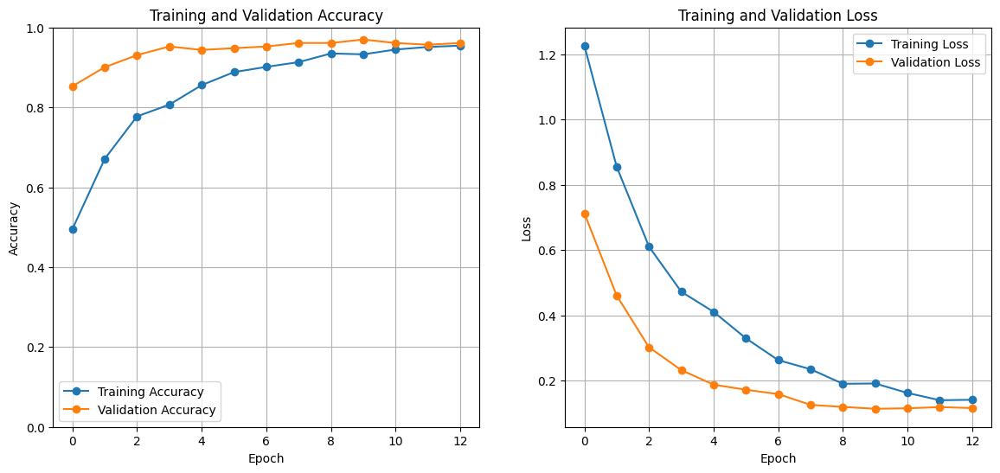

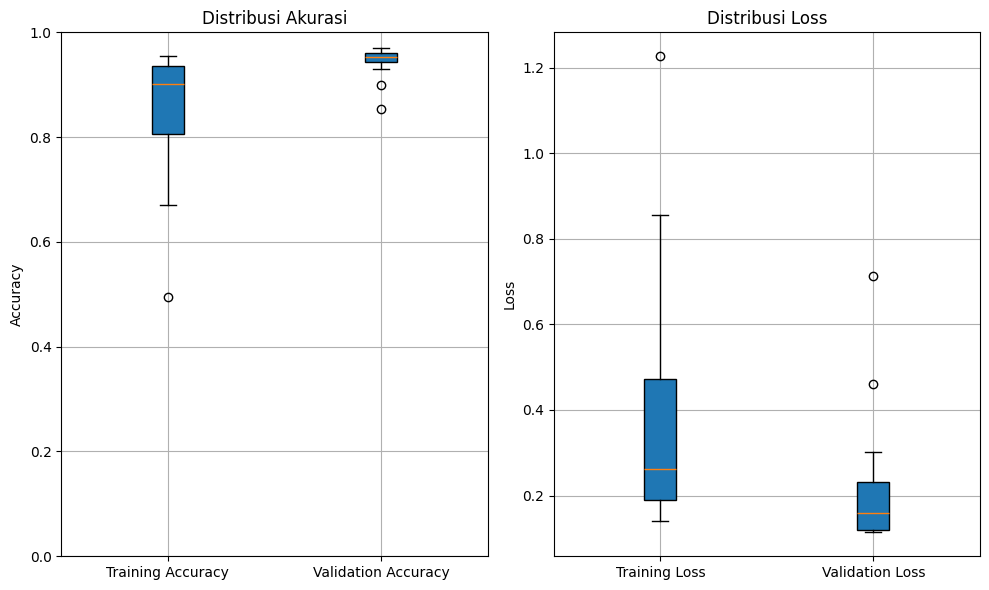


🚀 Training Fold 3 😌

Found 922 validated image filenames belonging to 4 classes.
Found 230 validated image filenames belonging to 4 classes.


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 120s 3s/step - accuracy: 0.4282 - loss: 1.4223 - val_accuracy: 0.8000 - val_loss: 0.6669 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 100s 3s/step - accuracy: 0.7011 - loss: 0.7592 - val_accuracy: 0.9043 - val_loss: 0.3891 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 100s 3s/step - accuracy: 0.8281 - loss: 0.4941 - val_accuracy: 0.9043 - val_loss: 0.3009 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 95s 3s/step - accuracy: 0.8735 - loss: 0.3810 - val_accuracy: 0.9261 - val_loss: 0.2477 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 95s 3s/step - accuracy: 0.8870 - loss: 0.2981 - val_accuracy: 0.9348 - val_loss: 0.2149 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 99s 3s/step - accuracy: 0.9080 - loss: 0.2258 - val_accuracy: 0.9391 - val_loss: 0.1823 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 92s 3s/step - accuracy: 0.9240 - lo

C:\Users\ASUS\AppData\Local\Temp\ipykernel_16504\4194638042.py:122: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_16504\4194638042.py:131: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


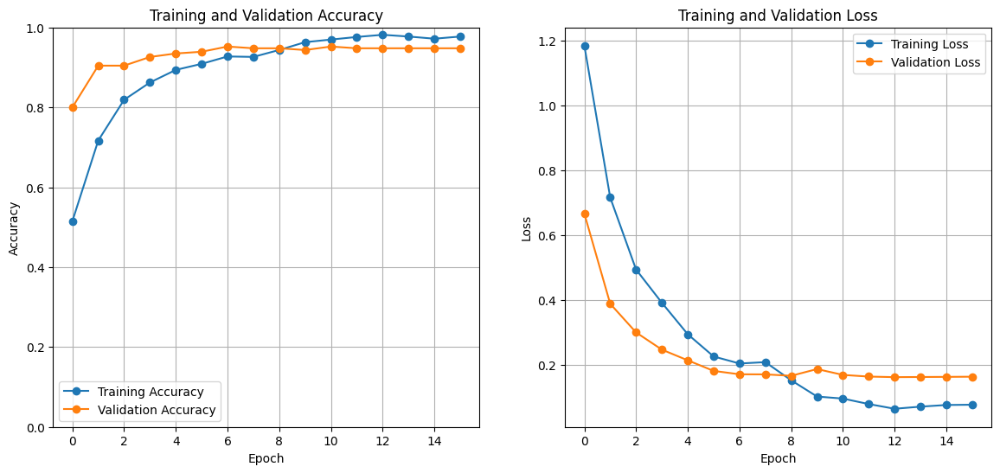

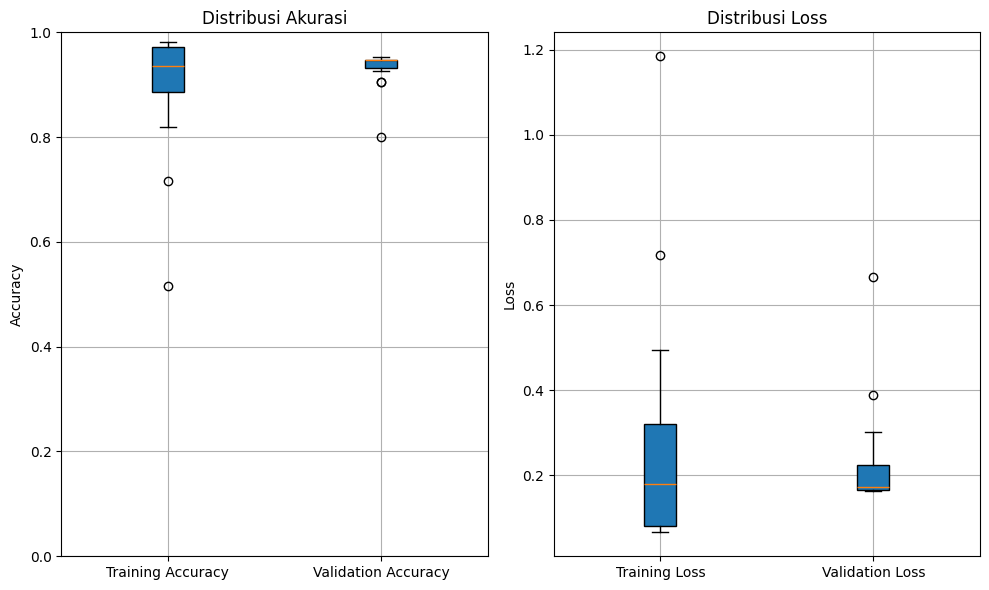


🚀 Training Fold 4 😌

Found 922 validated image filenames belonging to 4 classes.
Found 230 validated image filenames belonging to 4 classes.


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 122s 4s/step - accuracy: 0.3618 - loss: 1.6154 - val_accuracy: 0.7217 - val_loss: 0.8326 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 97s 3s/step - accuracy: 0.6535 - loss: 0.9076 - val_accuracy: 0.8348 - val_loss: 0.5899 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 98s 3s/step - accuracy: 0.7409 - loss: 0.6759 - val_accuracy: 0.9043 - val_loss: 0.4185 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 95s 3s/step - accuracy: 0.7928 - loss: 0.5055 - val_accuracy: 0.9043 - val_loss: 0.3638 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 98s 3s/step - accuracy: 0.8623 - loss: 0.4093 - val_accuracy: 0.9261 - val_loss: 0.2786 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 95s 3s/step - accuracy: 0.8811 - loss: 0.3314 - val_accuracy: 0.9261 - val_loss: 0.2430 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 101s 4s/step - accuracy: 0.9239 - los

C:\Users\ASUS\AppData\Local\Temp\ipykernel_16504\4194638042.py:122: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_16504\4194638042.py:131: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


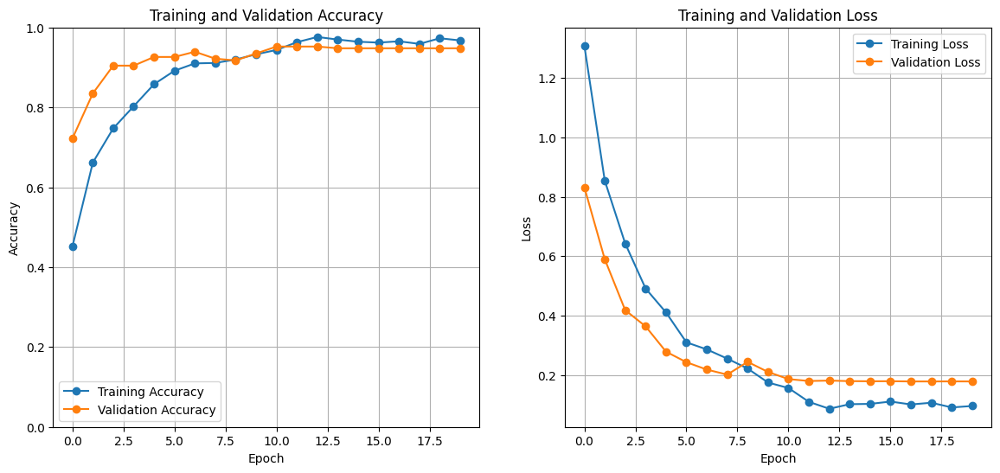

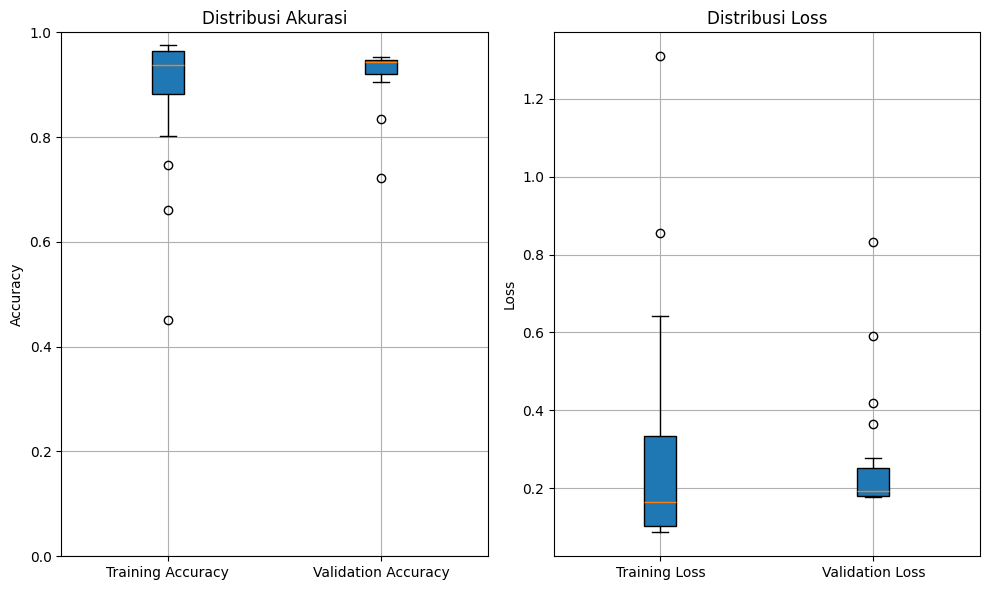


🚀 Training Fold 5 😌

Found 922 validated image filenames belonging to 4 classes.
Found 230 validated image filenames belonging to 4 classes.


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 123s 4s/step - accuracy: 0.4206 - loss: 1.5194 - val_accuracy: 0.8565 - val_loss: 0.7344 - learning_rate: 1.0000e-04
Epoch 2/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 102s 4s/step - accuracy: 0.6551 - loss: 0.8683 - val_accuracy: 0.9217 - val_loss: 0.4422 - learning_rate: 1.0000e-04
Epoch 3/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 97s 3s/step - accuracy: 0.7747 - loss: 0.6153 - val_accuracy: 0.9348 - val_loss: 0.2775 - learning_rate: 1.0000e-04
Epoch 4/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 96s 3s/step - accuracy: 0.8330 - loss: 0.4761 - val_accuracy: 0.9478 - val_loss: 0.2267 - learning_rate: 1.0000e-04
Epoch 5/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 95s 3s/step - accuracy: 0.8902 - loss: 0.3330 - val_accuracy: 0.9609 - val_loss: 0.1755 - learning_rate: 1.0000e-04
Epoch 6/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 93s 3s/step - accuracy: 0.8796 - loss: 0.3063 - val_accuracy: 0.9522 - val_loss: 0.1703 - learning_rate: 1.0000e-04
Epoch 7/20
29/29 ━━━━━━━━━━━━━━━━━━━━ 98s 3s/step - accuracy: 0.9249 - los

C:\Users\ASUS\AppData\Local\Temp\ipykernel_16504\4194638042.py:122: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
C:\Users\ASUS\AppData\Local\Temp\ipykernel_16504\4194638042.py:131: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,


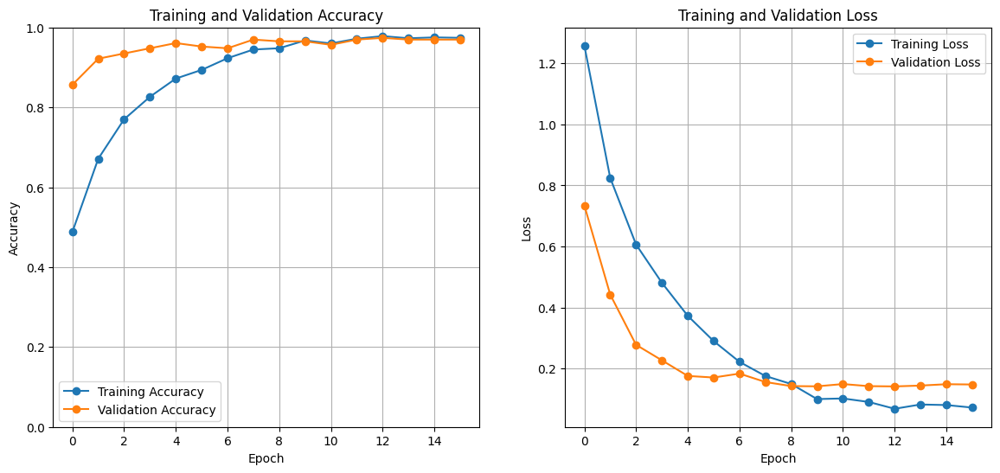

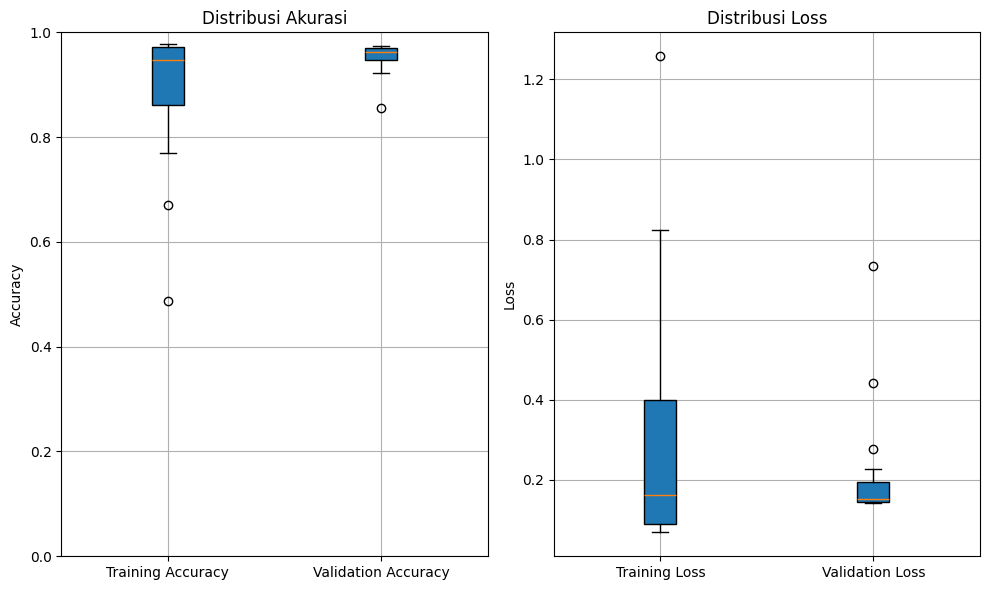

In [36]:
# Tentukan jumlah fold
n_splits = 5
kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

# Direktori untuk menyimpan model terbaik
best_model_dir = r'.\model P2' 

# Fungsi untuk membuat model
def create_model(num_classes):
    base_model = DenseNet169(weights='imagenet', include_top=False, input_shape=(IMAGE_WIDTH, IMAGE_HEIGHT, COLOR_CHANNELS))

    for layer in base_model.layers[:-10]:  # Membekukan semua kecuali 10 lapisan terakhir
        layer.trainable = False

    x = base_model.output
    x = Conv2D(32, (4, 4), activation='relu')(x)
    x = MaxPooling2D((2, 2))(x)
    x = Dropout(0.3)(x)
    x = Dense(64, activation='relu', name='FC2')(x) 
    x = Dropout(0.3)(x)
    x = Flatten()(x)
    x = Dropout(0.3)(x)
    predictions = Dense(num_classes, activation='softmax')(x)
    model = Model(inputs=base_model.input, outputs=predictions)
    model.compile(optimizer=RMSprop(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])
    
    # model.summary()
    return model


EPOCHS = 20
fold_var = 1

# Looping untuk setiap fold
for train_index, val_index in kf.split(file_paths):
    print(f"\n🚀 Training Fold {fold_var} 😌\n")

    # Split train and validation sets
    train_files, val_files = np.array(file_paths)[train_index], np.array(file_paths)[val_index]
    train_labels, val_labels = np.array(integer_labels)[train_index], np.array(integer_labels)[val_index]
    
    # Convert integer labels to class names
    df_train = pd.DataFrame({"filename": train_files, "class": [unique_labels[i] for i in train_labels]})
    df_val = pd.DataFrame({"filename": val_files, "class": [unique_labels[i] for i in val_labels]})


    train_generator = datagen.flow_from_dataframe(
        dataframe=df_train,       # DataFrame yang berisi informasi gambar (filename dan class)
        x_col="filename",         # Kolom yang berisi path ke gambar
        y_col="class",            # Kolom yang berisi label kelas gambar
        target_size=IMAGE_SIZE,   # Ukuran gambar yang akan diubah sebelum masuk ke model
        batch_size=BATCH_SIZE,    # Jumlah gambar yang akan diproses dalam satu batch
        class_mode="categorical", # Mode klasifikasi (multikategori)
        color_mode="rgb",         # Format warna gambar (RGB)
        shuffle=True
    )
    
    val_generator = datagen.flow_from_dataframe(
        dataframe=df_val,
        x_col="filename",
        y_col="class",
        target_size=IMAGE_SIZE,
        batch_size=BATCH_SIZE,
        class_mode="categorical",
        color_mode="rgb",
        shuffle=True
    )

    # Callbacks
    early_stopping = EarlyStopping(monitor='val_loss', patience=3, restore_best_weights=True, verbose=1)
    model_checkpoint = ModelCheckpoint(os.path.join(best_model_dir, f'best_model_{fold_var}.keras'), monitor='val_loss', save_best_only=True)
    
    # Buat Learning Rate Scheduler
    lr_scheduler = ReduceLROnPlateau(
        monitor='val_accuracy',     
        factor=0.1,             
        patience=3,             # Jika val_loss tidak membaik setelah 3 epoch, LR akan diturunkan
        min_lr=1e-6,            
        verbose=1               
    )

    num_classes = len(label_map)
    model = create_model(num_classes)

    # Training Model
    history = model.fit(
        train_generator,
        epochs=EPOCHS,
        validation_data=val_generator,
        callbacks=[early_stopping, model_checkpoint, lr_scheduler]
    )

    # Plot grafik akurasi dan loss dengan format yang lebih baik
    plt.figure(figsize=(14, 6))

    # Plot Training and Validation Accuracy
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Training Accuracy', marker='o')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy', marker='o')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.ylim(0, 1)  # Menentukan rentang y antara 0 dan 1 (untuk akurasi)
    plt.grid(True)
    plt.legend()

    # Plot Training and Validation Loss
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Training Loss', marker='o')
    plt.plot(history.history['val_loss'], label='Validation Loss', marker='o')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.grid(True)
    plt.legend()

    # Buat figure Box Plot
    plt.figure(figsize=(10, 6))
    
    # Boxplot untuk Training & Validation Accuracy
    plt.subplot(1, 2, 1)
    plt.boxplot([history.history['accuracy'], history.history['val_accuracy']], vert=True, patch_artist=True,
                labels=['Training Accuracy', 'Validation Accuracy'])
    plt.title('Distribusi Akurasi')
    plt.ylabel('Accuracy')
    plt.ylim(0, 1)
    plt.grid(True)
    
    # Boxplot untuk Training & Validation Loss
    plt.subplot(1, 2, 2)
    plt.boxplot([history.history['loss'], history.history['val_loss']], vert=True, patch_artist=True,
                labels=['Training Loss', 'Validation Loss'])
    plt.title('Distribusi Loss')
    plt.ylabel('Loss')
    plt.grid(True)

    # Tampilkan grafik
    plt.tight_layout()
    plt.show()

    # menambah fold
    fold_var += 1

In [5]:
import numpy as np

# Contoh hasil akurasi dari 5 fold
accuracies = [95.24, 96.97, 94.78, 94.78, 97.39]

# Menghitung standar deviasi
std_dev = np.std(accuracies)

print(f"Standar Deviasi Akurasi Model P2: {std_dev:.4f}")


Standar Deviasi Akurasi Model P2: 1.1213


In [ ]:
from sklearn.metrics import roc_auc_score, roc_curve, auc
from sklearn.preprocessing import label_binarize

def evaluate_model(fold_count, test_generator, model_path='./model P2/best_model_'):
    for fold in range(1, fold_count + 1):
        print('\n\n')
        print(f"Evaluasi KFold {fold} ...")
        
        # Load model
        loaded_model = load_model(f'{model_path}{fold}.keras')

        # Prediksi pada data testing
        predictions = loaded_model.predict(test_generator)

        # Ambil label sebenarnya dari generator
        true_labels = test_generator.classes
        
        # Konversi label ke bentuk one-hot
        num_classes = predictions.shape[1]
        y_true = label_binarize(true_labels, classes=range(num_classes))
        
        # Hitung skor AUC macro
        auc_score = roc_auc_score(y_true, predictions, average='macro', multi_class='ovr')
        print(f"Skor AUC (macro-average) untuk Fold {fold}: {auc_score:.4f}")

        # Plot ROC Curve untuk setiap kelas
        fpr = dict()
        tpr = dict()
        roc_auc = dict()

        for i in range(num_classes):
            fpr[i], tpr[i], _ = roc_curve(y_true[:, i], predictions[:, i])
            roc_auc[i] = auc(fpr[i], tpr[i])

        # Plot semua ROC dalam 1 grafik
        plt.figure(figsize=(10, 8))
        for i in range(num_classes):
            plt.plot(fpr[i], tpr[i], label=f'Kelas {i} (AUC = {roc_auc[i]:.2f})')

        plt.plot([0, 1], [0, 1], 'k--')  # Garis diagonal random guess
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title(f'ROC Curve Fold {fold}')
        plt.legend(loc='lower right')
        plt.grid(True)
        plt.show()

evaluate_model(fold_count=5, test_generator=test_generator)




Kfold 1 ...


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


10/10 ━━━━━━━━━━━━━━━━━━━━ 32s 3s/step


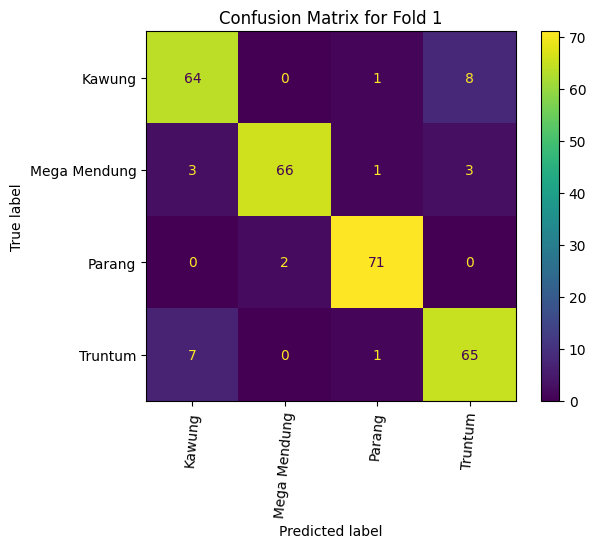

Classification Report
              precision    recall  f1-score   support

      Kawung     0.8649    0.8767    0.8707        73
Mega Mendung     0.9706    0.9041    0.9362        73
      Parang     0.9595    0.9726    0.9660        73
     Truntum     0.8553    0.8904    0.8725        73

    accuracy                         0.9110       292
   macro avg     0.9125    0.9110    0.9113       292
weighted avg     0.9125    0.9110    0.9113       292




Kfold 2 ...
10/10 ━━━━━━━━━━━━━━━━━━━━ 32s 3s/step


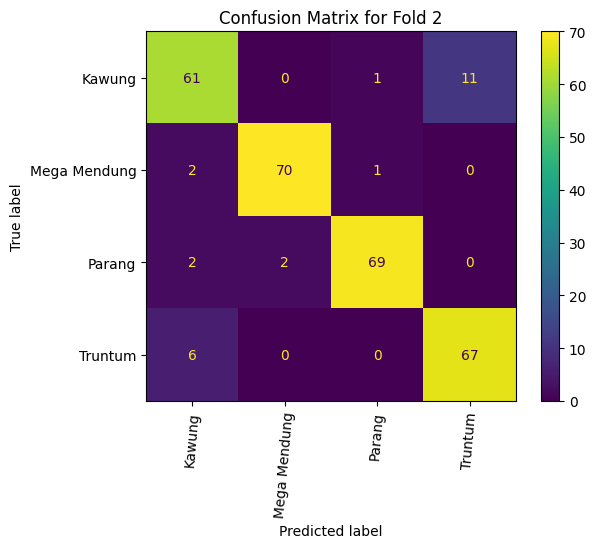

Classification Report
              precision    recall  f1-score   support

      Kawung     0.8592    0.8356    0.8472        73
Mega Mendung     0.9722    0.9589    0.9655        73
      Parang     0.9718    0.9452    0.9583        73
     Truntum     0.8590    0.9178    0.8874        73

    accuracy                         0.9144       292
   macro avg     0.9155    0.9144    0.9146       292
weighted avg     0.9155    0.9144    0.9146       292




Kfold 3 ...
10/10 ━━━━━━━━━━━━━━━━━━━━ 31s 3s/step


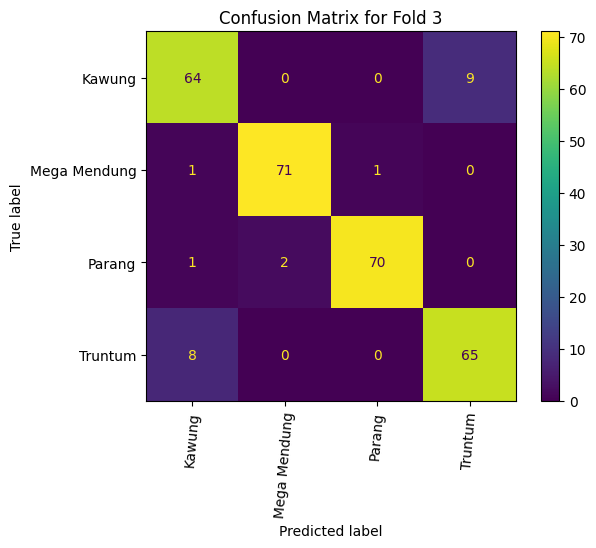

Classification Report
              precision    recall  f1-score   support

      Kawung     0.8649    0.8767    0.8707        73
Mega Mendung     0.9726    0.9726    0.9726        73
      Parang     0.9859    0.9589    0.9722        73
     Truntum     0.8784    0.8904    0.8844        73

    accuracy                         0.9247       292
   macro avg     0.9254    0.9247    0.9250       292
weighted avg     0.9254    0.9247    0.9250       292




Kfold 4 ...
10/10 ━━━━━━━━━━━━━━━━━━━━ 32s 3s/step


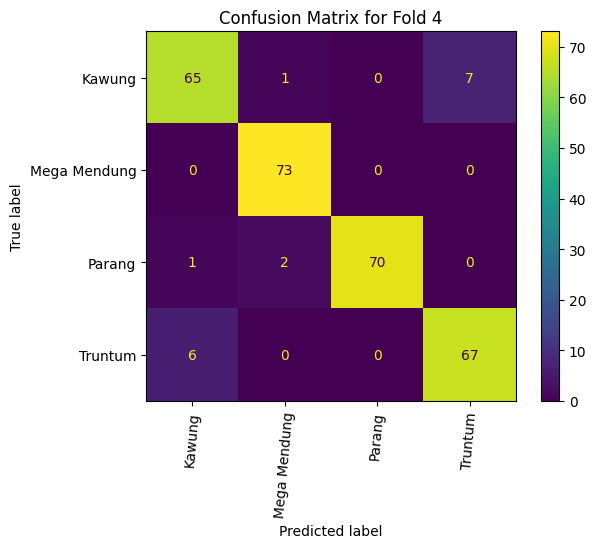

Classification Report
              precision    recall  f1-score   support

      Kawung     0.9028    0.8904    0.8966        73
Mega Mendung     0.9605    1.0000    0.9799        73
      Parang     1.0000    0.9589    0.9790        73
     Truntum     0.9054    0.9178    0.9116        73

    accuracy                         0.9418       292
   macro avg     0.9422    0.9418    0.9418       292
weighted avg     0.9422    0.9418    0.9418       292




Kfold 5 ...
10/10 ━━━━━━━━━━━━━━━━━━━━ 33s 3s/step


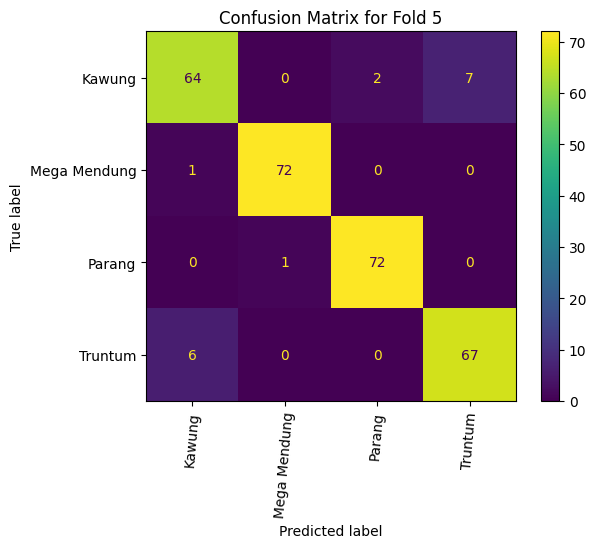

Classification Report
              precision    recall  f1-score   support

      Kawung     0.9014    0.8767    0.8889        73
Mega Mendung     0.9863    0.9863    0.9863        73
      Parang     0.9730    0.9863    0.9796        73
     Truntum     0.9054    0.9178    0.9116        73

    accuracy                         0.9418       292
   macro avg     0.9415    0.9418    0.9416       292
weighted avg     0.9415    0.9418    0.9416       292



In [10]:
def evaluate_model(fold_count, test_generator, model_path='./model P2/best_model_'):
    for fold in range(1, fold_count + 1):
        print('\n\n')
        print(f"Kfold {fold} ...")
        loaded_model = load_model(f'{model_path}{fold}.keras')
        
        predictions = loaded_model.predict(test_generator)
        
        # Get class labels
        class_labels = list(test_generator.class_indices.keys())
        
        # Get the true and predicted class indices
        y_true = test_generator.classes
        y_pred = np.argmax(predictions, axis=1)
        
        # Confusion Matrix Display
        conf_matrix = confusion_matrix(y_true, y_pred)
        disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=class_labels)
        
        disp.plot(cmap='viridis')
        plt.title(f'Confusion Matrix for Fold {fold}')
        plt.xticks(rotation=85)
        plt.show()
        
        class_report = classification_report(y_true, y_pred, target_names=class_labels, digits=4)
        print('Classification Report')
        print(class_report)

evaluate_model(fold_count=5, test_generator=test_generator)




Evaluasi KFold 1 ...


c:\Users\ASUS\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


10/10 ━━━━━━━━━━━━━━━━━━━━ 37s 3s/step
Skor AUC (macro-average) untuk Fold 1: 0.9923


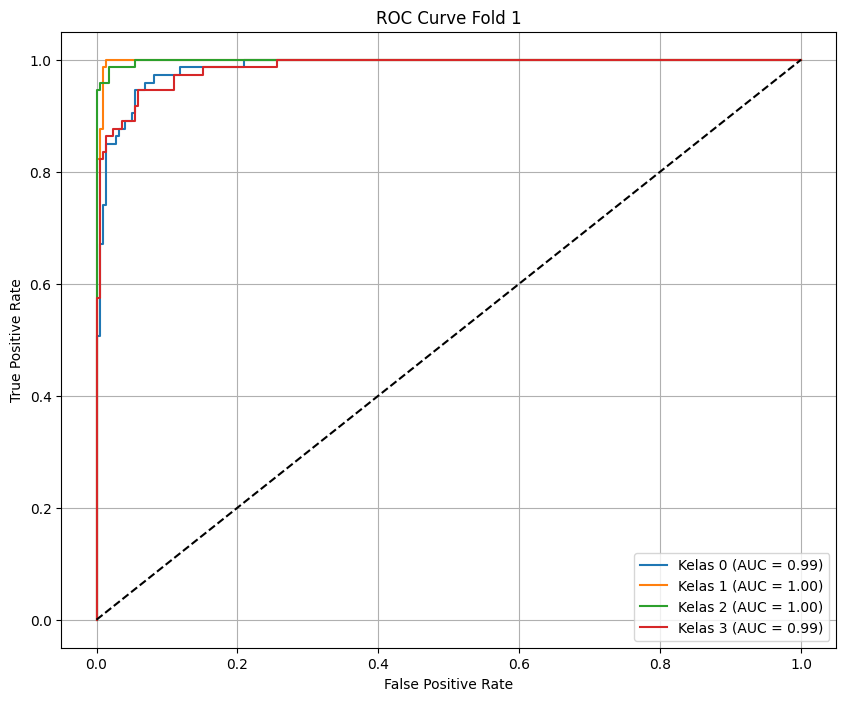




Evaluasi KFold 2 ...
10/10 ━━━━━━━━━━━━━━━━━━━━ 33s 3s/step
Skor AUC (macro-average) untuk Fold 2: 0.9916


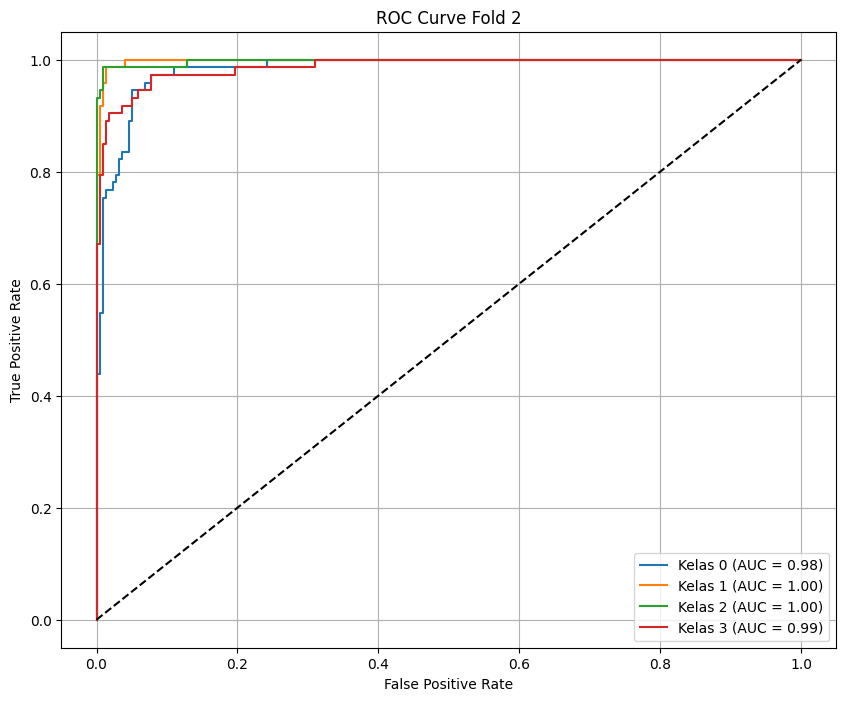




Evaluasi KFold 3 ...
10/10 ━━━━━━━━━━━━━━━━━━━━ 34s 3s/step
Skor AUC (macro-average) untuk Fold 3: 0.9914


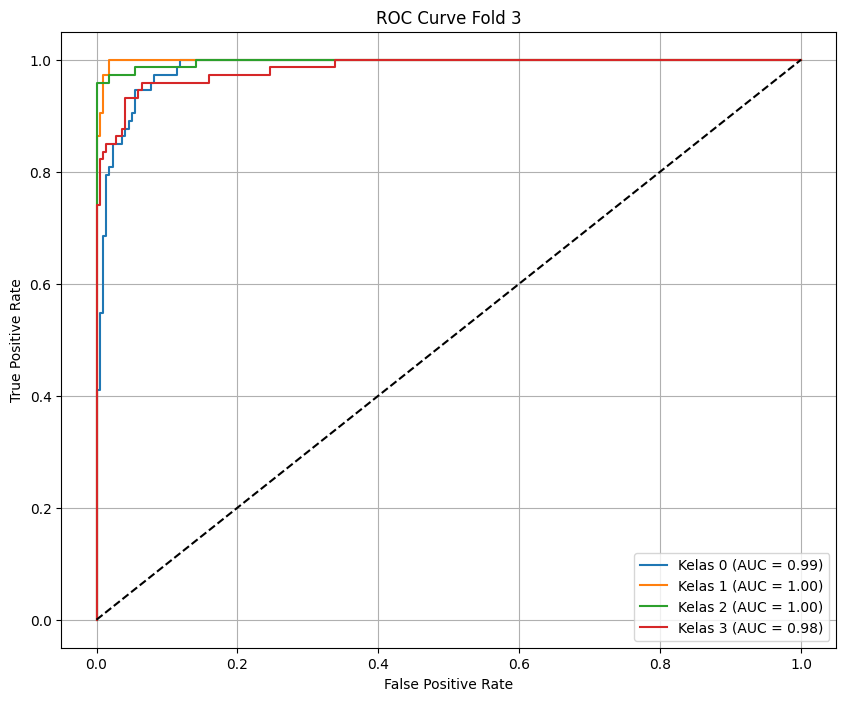




Evaluasi KFold 4 ...
10/10 ━━━━━━━━━━━━━━━━━━━━ 35s 3s/step
Skor AUC (macro-average) untuk Fold 4: 0.9912


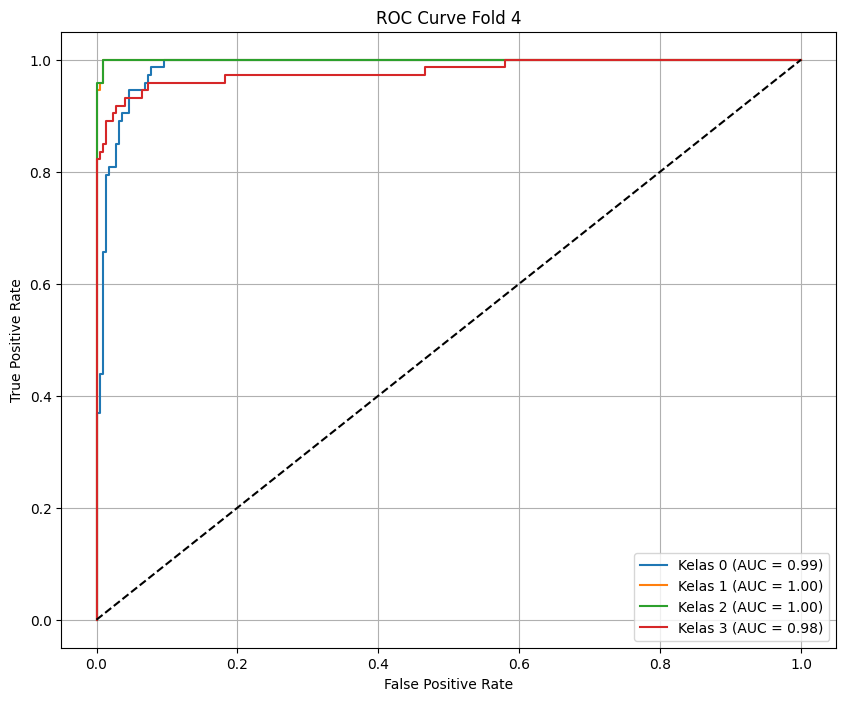




Evaluasi KFold 5 ...
10/10 ━━━━━━━━━━━━━━━━━━━━ 35s 3s/step
Skor AUC (macro-average) untuk Fold 5: 0.9928


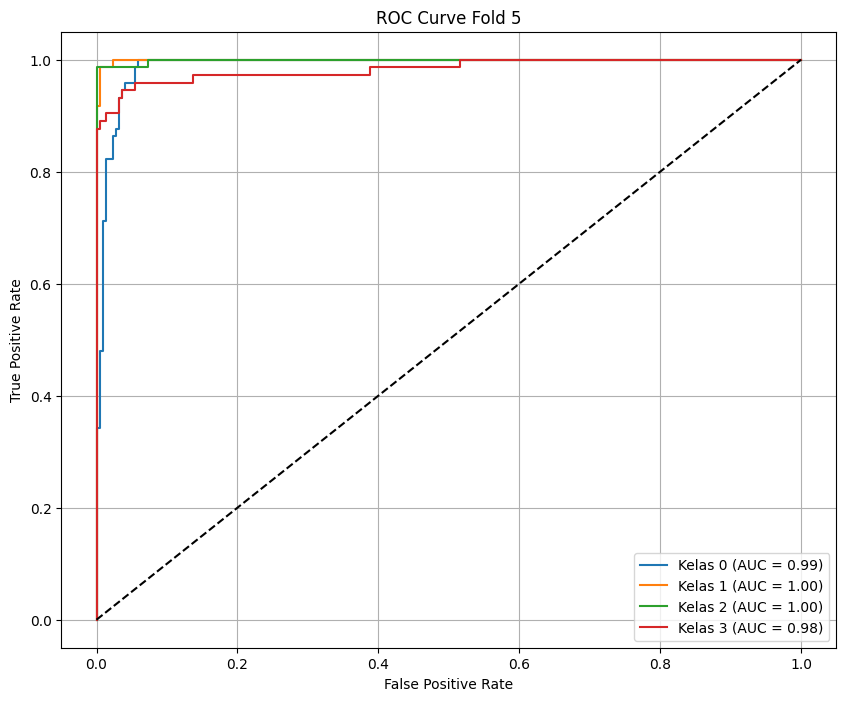

In [6]:
from sklearn.metrics import roc_auc_score, roc_curve, auc
from sklearn.preprocessing import label_binarize

def evaluate_model(fold_count, test_generator, model_path='./model P2/best_model_'):
    for fold in range(1, fold_count + 1):
        print('\n\n')
        print(f"Evaluasi KFold {fold} ...")
        
        # Load model
        loaded_model = load_model(f'{model_path}{fold}.keras')

        # Prediksi pada data testing
        predictions = loaded_model.predict(test_generator)

        # Ambil label sebenarnya dari generator
        true_labels = test_generator.classes
        
        # Konversi label ke bentuk one-hot
        num_classes = predictions.shape[1]
        y_true = label_binarize(true_labels, classes=range(num_classes))
        
        # Hitung skor AUC macro
        auc_score = roc_auc_score(y_true, predictions, average='macro', multi_class='ovr')
        print(f"Skor AUC (macro-average) untuk Fold {fold}: {auc_score:.4f}")

        # Plot ROC Curve untuk setiap kelas
        fpr = dict()
        tpr = dict()
        roc_auc = dict()

        for i in range(num_classes):
            fpr[i], tpr[i], _ = roc_curve(y_true[:, i], predictions[:, i])
            roc_auc[i] = auc(fpr[i], tpr[i])

        # Plot semua ROC dalam 1 grafik
        plt.figure(figsize=(10, 8))
        for i in range(num_classes):
            plt.plot(fpr[i], tpr[i], label=f'Kelas {i} (AUC = {roc_auc[i]:.2f})')

        plt.plot([0, 1], [0, 1], 'k--')  # Garis diagonal random guess
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title(f'ROC Curve Fold {fold}')
        plt.legend(loc='lower right')
        plt.grid(True)
        plt.show()

evaluate_model(fold_count=5, test_generator=test_generator)

### manual true false

1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


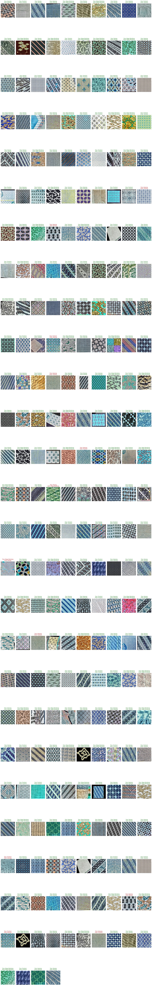

In [ ]:
model = load_model('./best model/best_model_4.keras')

# Get total samples in validation set
num_samples = val_generator.samples

# Initialize empty lists to store images, true labels, and predictions
all_images = []
all_true_labels = []
all_pred_labels = []

# Iterate through the entire validation set
for i in range(len(test_generator)):  # Loop through all batches
    val_images, val_labels = next(val_generator)  # Get batch
    predictions = model.predict(val_images)  # Get predictions

    all_images.extend(val_images)  # Store images
    all_true_labels.extend(np.argmax(val_labels, axis=1))  # Store true labels
    all_pred_labels.extend(np.argmax(predictions, axis=1))  # Store predicted labels

# Convert lists to numpy arrays
all_images = np.array(all_images)
all_true_labels = np.array(all_true_labels)
all_pred_labels = np.array(all_pred_labels)

# Plot all images with true & predicted labels
fig, axes = plt.subplots(len(all_images) // 10 + 1, 10, figsize=(20, len(all_images) // 2))

for i, ax in enumerate(axes.flat):
    if i >= len(all_images):  
        ax.axis('off')  # Hide empty plots
        continue  

    ax.imshow(all_images[i])  # Show the image
    true_label = labels[all_true_labels[i]]  # Get true class name
    pred_label = labels[all_pred_labels[i]]  # Get predicted class name

    # Display true & predicted labels
    ax.set_title(f"True: {true_label}\nPred: {pred_label}", fontsize=10,
                 color="green" if true_label == pred_label else "red")

    ax.axis('off')

plt.tight_layout()
plt.show()